## Chest X-ray classification Project



### Objectives
----train-----

1.	Process and use multi-label X-ray image datasets. And plan special training methods according to its characteristics.

2.	Develop a CNN model to do multi-label classification on Chest X-ray image.

3.	Perform analysis on the same dataset using the available ViT Transformer model and ResNet model for medical analysis.

-----evaluation------

4.	Evaluate project made CNN model through confusion matrix, accuracy, recall, top-K accuracy or more, and compare it with two other models.

5.	Produce CNN Grad-CAM for discussable X-ray image


### Setup and resources 
This project will use a random subset of images from NIH chest x-ray images, which is a subset of the [NIH dataset](https://www.kaggle.com/datasets/nih-chest-xrays/data). Our subset of NIH chest xray dataset contains **15 different symptom** that labled using NLP with 90%+ accuracy.  It has more than 100000 chest x-ray images, each of the image has 1024*1024 pixel. The sample dataset have 5% of the full dataset image.
Here is the link to Kaggle challenge website:

>[Direct access to full dataset](https://www.kaggle.com/datasets/nih-chest-xrays/data)
>[Access to sample dataset](https://www.kaggle.com/datasets/nih-chest-xrays/sample?resource=download) 

please use kaggle api to download the dataset

**Final note:**



In [1]:
import math
import gc
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.hub import load_state_dict_from_url
import torchsummary
from PIL import Image, UnidentifiedImageError,ImageOps
import matplotlib.pyplot as plt
import time
from sklearn.metrics import precision_recall_curve
import os
from torch.utils.data import Dataset
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import ImageFolder
import torchvision
import torch.optim as optim
from pandas import DataFrame
import pandas as pd
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from tqdm import tqdm
import torchvision.models as models
import pickle
import random

from sklearn.metrics import multilabel_confusion_matrix
#pip install scikit-image

In [2]:

"""
ROOT="/content/drive/My Drive/DLCW1/data/"
cnnmodel_epochs = 50
imprcnnmodel_eprochs = 50
alexNetmodel_eprochs = 10
batch_size = 64
num_workers=2
"""
ROOT="extracted_files/"
#ROOT="sample/"
#ROOT="/content/drive/My Drive/DLCW1/data/"
cnnmodel_epochs = 150
imprcnnmodel_eprochs = 150
alexNetmodel_eprochs = 100
batch_size = 24
num_workers=12
img_size=384
"""
"""


'\n'

In [3]:
medical_terms = {
    'Hernia': 0,
    'Pneumonia': 1,
    'Fibrosis': 2,
    'Edema': 3,
    'Emphysema': 4,
    'Cardiomegaly': 5,
    'Pleural_Thickening': 6,
    'Consolidation': 7,
    'Pneumothorax': 8,
    'Mass': 9,
    'Nodule': 10,
    'Atelectasis': 11,
    'Effusion': 12,
    'Infiltration': 13,
    'No Finding': 14
}
reversed_medical_terms = {v: k for k, v in medical_terms.items()}

In [4]:
clables = list(medical_terms.keys())
print(clables)

['Hernia', 'Pneumonia', 'Fibrosis', 'Edema', 'Emphysema', 'Cardiomegaly', 'Pleural_Thickening', 'Consolidation', 'Pneumothorax', 'Mass', 'Nodule', 'Atelectasis', 'Effusion', 'Infiltration', 'No Finding']


In [5]:
print(torch.__version__)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

2.0.0+cu118
Using device: cuda


In [6]:
df = pd.read_csv(ROOT+'Data_Entry_2017.csv')
#df = pd.read_csv('sample_labels.csv')

In [7]:
df

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y],Unnamed: 11
0,00000001_000.png,Cardiomegaly,0,1,58,M,PA,2682,2749,0.143,0.143,NaN
1,00000001_001.png,Cardiomegaly|Emphysema,1,1,58,M,PA,2894,2729,0.143,0.143,NaN
2,00000001_002.png,Cardiomegaly|Effusion,2,1,58,M,PA,2500,2048,0.168,0.168,NaN
3,00000002_000.png,No Finding,0,2,81,M,PA,2500,2048,0.171,0.171,NaN
4,00000003_000.png,Hernia,0,3,81,F,PA,2582,2991,0.143,0.143,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
112115,00030801_001.png,Mass|Pneumonia,1,30801,39,M,PA,2048,2500,0.168,0.168,NaN
112116,00030802_000.png,No Finding,0,30802,29,M,PA,2048,2500,0.168,0.168,NaN
112117,00030803_000.png,No Finding,0,30803,42,F,PA,2048,2500,0.168,0.168,NaN
112118,00030804_000.png,No Finding,0,30804,30,F,PA,2048,2500,0.168,0.168,NaN


## Data Clean and Data Analysis

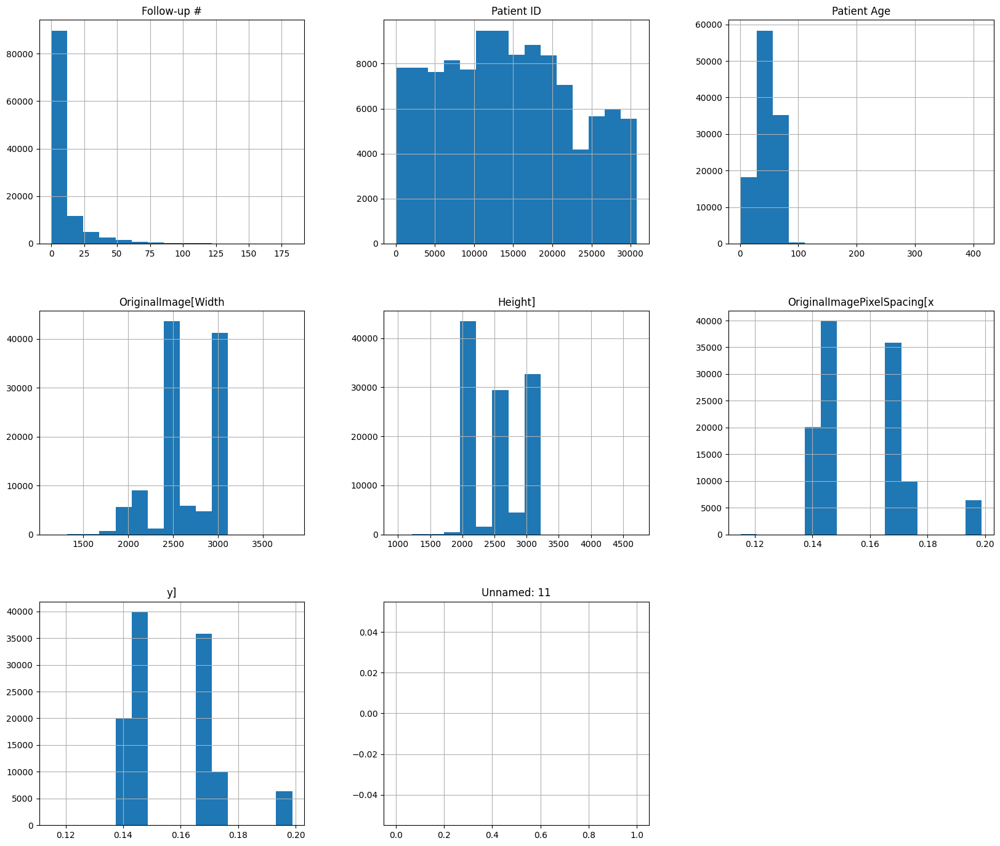

In [8]:
df.hist(bins=15, figsize=(20,17))
plt.show()

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112120 entries, 0 to 112119
Data columns (total 12 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Image Index                  112120 non-null  object 
 1   Finding Labels               112120 non-null  object 
 2   Follow-up #                  112120 non-null  int64  
 3   Patient ID                   112120 non-null  int64  
 4   Patient Age                  112120 non-null  int64  
 5   Patient Gender               112120 non-null  object 
 6   View Position                112120 non-null  object 
 7   OriginalImage[Width          112120 non-null  int64  
 8   Height]                      112120 non-null  int64  
 9   OriginalImagePixelSpacing[x  112120 non-null  float64
 10  y]                           112120 non-null  float64
 11  Unnamed: 11                  0 non-null       float64
dtypes: float64(3), int64(5), object(4)
memory usage: 10.3+ MB


In [10]:
df["Finding Labels"] = df["Finding Labels"].str.split("|")

In [11]:
df = df.drop(columns=['Unnamed: 11'])

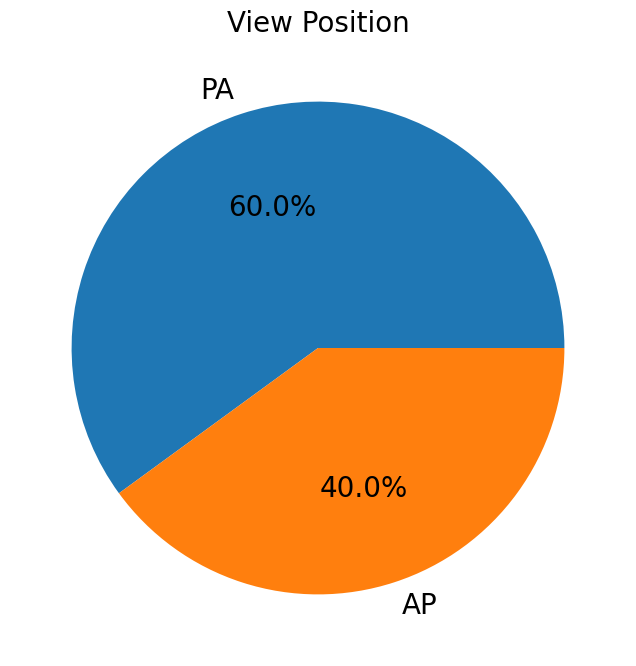

In [12]:
plt.rcParams['font.size'] = 12
gender_counts = df['View Position'].value_counts()
plt.figure(figsize=(8,8))
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%', textprops={'fontsize': 20})
plt.title('View Position', fontsize=20)
plt.show()

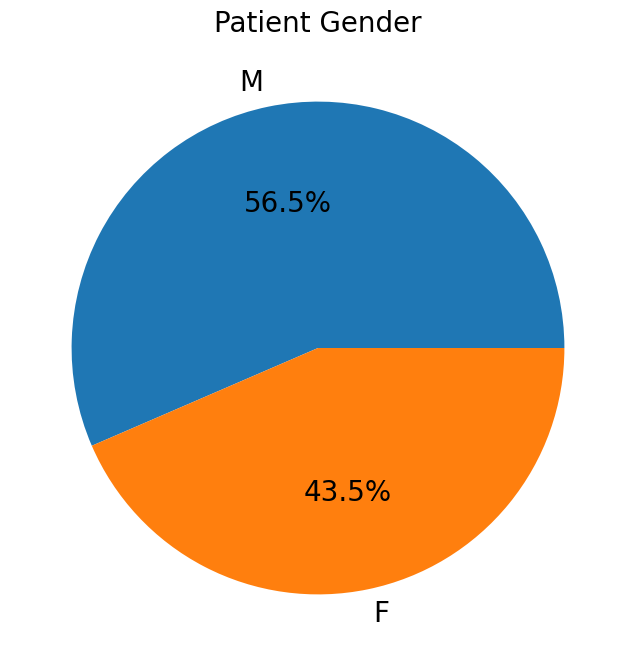

In [13]:
gender_counts = df['Patient Gender'].value_counts()
plt.figure(figsize=(8,8))
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%', textprops={'fontsize': 20})
plt.title('Patient Gender',fontsize=20)
plt.show()

In [14]:
# Find all the AP sample
ap_rows = df[df['View Position'] == 'AP']
# random choose 5 sample
random_five = ap_rows.sample(n=5)
print(random_five)


             Image Index Finding Labels  Follow-up #  Patient ID  Patient Age   
57550   00014264_010.png   [No Finding]           10       14264           58  \
24422   00006425_013.png  [Atelectasis]           13        6425           49   
105191  00028232_002.png   [No Finding]            2       28232           59   
81529   00020043_015.png   [No Finding]           15       20043           45   
19018   00005066_014.png  [Atelectasis]           14        5066           50   

       Patient Gender View Position  OriginalImage[Width  Height]   
57550               M            AP                 2500     2048  \
24422               M            AP                 2500     2048   
105191              M            AP                 3056     2544   
81529               F            AP                 2548     2544   
19018               M            AP                 2500     2048   

        OriginalImagePixelSpacing[x     y]  
57550                         0.168  0.168  
24422   

In [15]:
# Find all the PA sample
ap_rows = df[df['View Position'] == 'PA']
# random choose 5 sample
random_five = ap_rows.sample(n=5)
print(random_five)


             Image Index      Finding Labels  Follow-up #  Patient ID   
68011   00016796_007.png        [No Finding]            7       16796  \
100862  00026795_000.png        [No Finding]            0       26795   
89662   00022263_004.png  [Effusion, Nodule]            4       22263   
58602   00014505_000.png        [No Finding]            0       14505   
103808  00027709_000.png        [No Finding]            0       27709   

        Patient Age Patient Gender View Position  OriginalImage[Width   
68011            64              F            PA                 2992  \
100862           56              M            PA                 2021   
89662            65              M            PA                 2992   
58602            46              F            PA                 2698   
103808            3              M            PA                 2544   

        Height]  OriginalImagePixelSpacing[x        y]  
68011      2991                     0.143000  0.143000  
100862  

In [16]:
label_counts = {}
mutilable=0
for labels in df["Finding Labels"]:
    if len(labels)>1:
        mutilable+=1
    for label in labels:
        if label in label_counts:
            label_counts[label]+=1
        else:
            label_counts[label] = 1
label_counts_df = pd.DataFrame.from_dict(label_counts, orient="index", columns=["Count"])
print(label_counts_df)
print("mutilabel     "+str(mutilable)+"/"+str(len(df)))

                    Count
Cardiomegaly         2776
Emphysema            2516
Effusion            13317
No Finding          60361
Hernia                227
Infiltration        19894
Mass                 5782
Nodule               6331
Atelectasis         11559
Pneumothorax         5302
Pleural_Thickening   3385
Pneumonia            1431
Fibrosis             1686
Edema                2303
Consolidation        4667
mutilabel     20796/112120


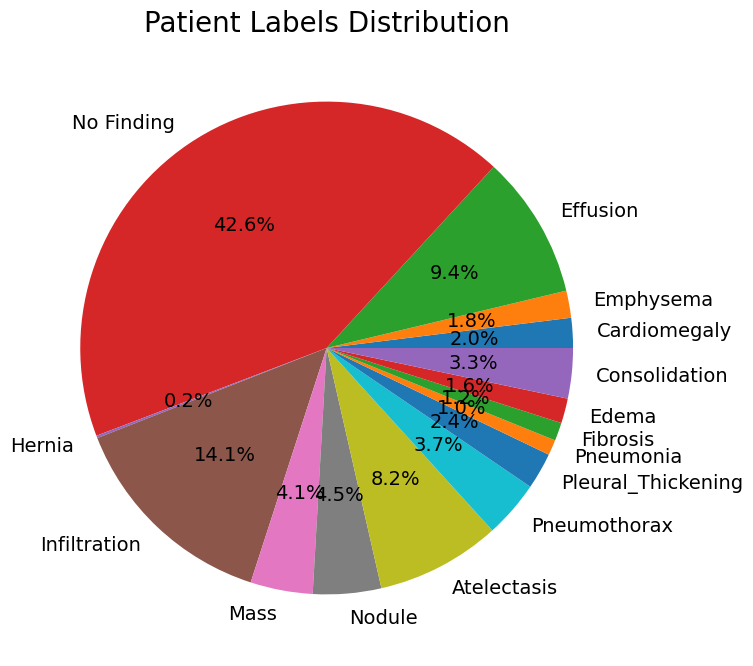

In [17]:
fig = plt.figure(figsize=(8, 8))
plt.rcParams['font.size'] = 11
plt.pie(label_counts.values(), labels=label_counts.keys(), autopct='%1.1f%%', textprops={'fontsize': 14})
plt.title("Patient Labels Distribution",fontsize=20)
plt.show()

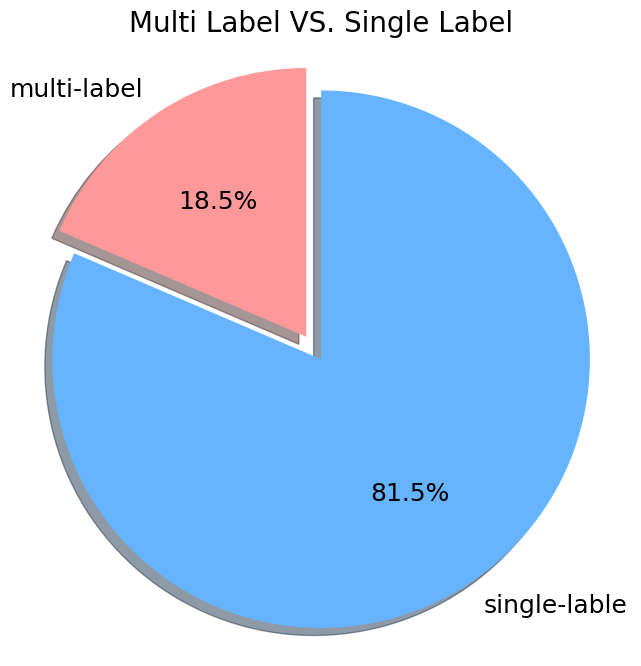

In [18]:
fig = plt.figure(figsize=(8, 8))
labels = ['multi-label', 'single-lable']
sizes = [20796, 112120-20796]
colors = ['#ff9999','#66b3ff']
explode = (0.1, 0)
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=90, textprops={'fontsize': 18})
plt.title('Multi Label VS. Single Label',fontsize=20)
plt.axis('equal')
plt.show()

In [19]:
single_no_finding_rows = df[df['Finding Labels'].apply(lambda x: x == ['No Finding'])]
num_rows_to_remove = 45000
rows_to_remove = random.sample(single_no_finding_rows.index.tolist(), num_rows_to_remove)
df = df.drop(rows_to_remove)
df = df.reset_index(drop=True)

In [20]:
df

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y]
0,00000001_000.png,[Cardiomegaly],0,1,58,M,PA,2682,2749,0.143000,0.143000
1,00000001_001.png,"[Cardiomegaly, Emphysema]",1,1,58,M,PA,2894,2729,0.143000,0.143000
2,00000001_002.png,"[Cardiomegaly, Effusion]",2,1,58,M,PA,2500,2048,0.168000,0.168000
3,00000002_000.png,[No Finding],0,2,81,M,PA,2500,2048,0.171000,0.171000
4,00000003_000.png,[Hernia],0,3,81,F,PA,2582,2991,0.143000,0.143000
...,...,...,...,...,...,...,...,...,...,...,...
67115,00030796_000.png,[No Finding],0,30796,44,M,PA,2021,2021,0.194311,0.194311
67116,00030799_000.png,[No Finding],0,30799,32,M,PA,2048,2500,0.171000,0.171000
67117,00030800_000.png,[No Finding],0,30800,34,F,PA,2048,2500,0.168000,0.168000
67118,00030801_001.png,"[Mass, Pneumonia]",1,30801,39,M,PA,2048,2500,0.168000,0.168000


In [21]:
label_counts = {}
mutilable=0
for labels in df["Finding Labels"]:
    if len(labels)>1:
        mutilable+=1
    for label in labels:
        if label in label_counts:
            label_counts[label]+=1
        else:
            label_counts[label] = 1

label_counts_df = pd.DataFrame.from_dict(label_counts, orient="index", columns=["Count"])

print(label_counts_df)
print("mutilabel     "+str(mutilable)+"/"+str(len(df)))

                    Count
Cardiomegaly         2776
Emphysema            2516
Effusion            13317
No Finding          15361
Hernia                227
Infiltration        19894
Mass                 5782
Nodule               6331
Atelectasis         11559
Pneumothorax         5302
Pleural_Thickening   3385
Pneumonia            1431
Fibrosis             1686
Edema                2303
Consolidation        4667
mutilabel     20796/77120


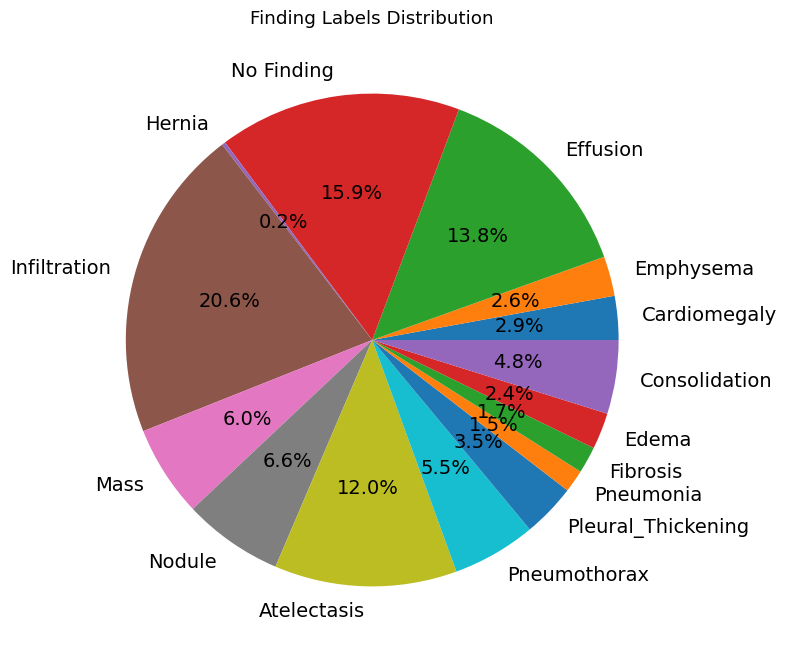

In [22]:
fig = plt.figure(figsize=(8, 8))
plt.rcParams['font.size'] = 11
plt.pie(label_counts.values(), labels=label_counts.keys(), autopct='%1.1f%%', textprops={'fontsize': 14})
plt.title("Finding Labels Distribution")
plt.show()

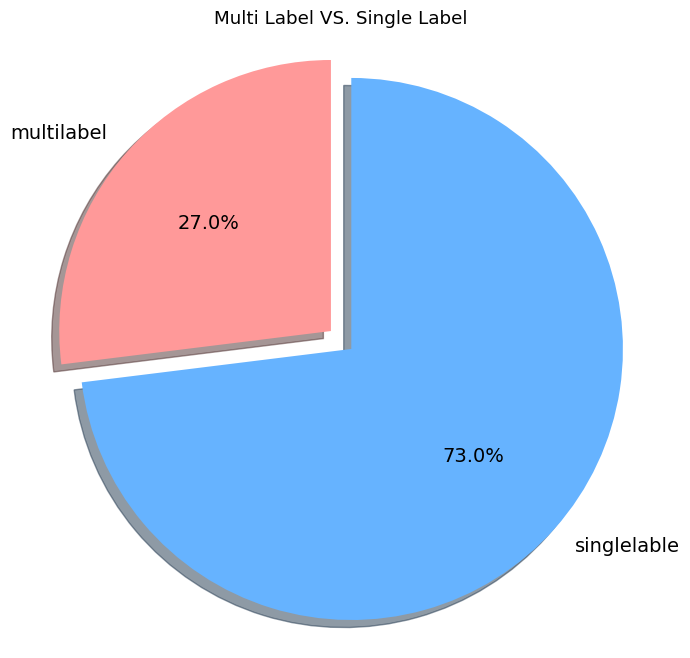

In [23]:
fig = plt.figure(figsize=(8, 8))
labels = ['multilabel', 'singlelable']
sizes = [20796, 77120-20796]
colors = ['#ff9999','#66b3ff']
explode = (0.1, 0)
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=90, textprops={'fontsize': 14})
plt.title('Multi Label VS. Single Label')
plt.axis('equal')
plt.show()

In [24]:
folder_path = ROOT
def get_all_files(folder_path):
    file_list = []
    for root, directories, filenames in tqdm(os.walk(folder_path)):
        for filename in filenames:
            file_path = os.path.join(root, filename)
            file_list.append(filename)
    return file_list
all_files = get_all_files(folder_path)
png_file_names = [filename for filename in all_files if filename.endswith('.png')]

25it [02:16,  5.46s/it]


In [25]:
filtered_df = df[df['Image Index'].isin(png_file_names)]
filtered_df = filtered_df.reset_index(drop=True)

In [26]:
filtered_df

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y]
0,00000001_000.png,[Cardiomegaly],0,1,58,M,PA,2682,2749,0.143000,0.143000
1,00000001_001.png,"[Cardiomegaly, Emphysema]",1,1,58,M,PA,2894,2729,0.143000,0.143000
2,00000001_002.png,"[Cardiomegaly, Effusion]",2,1,58,M,PA,2500,2048,0.168000,0.168000
3,00000002_000.png,[No Finding],0,2,81,M,PA,2500,2048,0.171000,0.171000
4,00000003_000.png,[Hernia],0,3,81,F,PA,2582,2991,0.143000,0.143000
...,...,...,...,...,...,...,...,...,...,...,...
67115,00030796_000.png,[No Finding],0,30796,44,M,PA,2021,2021,0.194311,0.194311
67116,00030799_000.png,[No Finding],0,30799,32,M,PA,2048,2500,0.171000,0.171000
67117,00030800_000.png,[No Finding],0,30800,34,F,PA,2048,2500,0.168000,0.168000
67118,00030801_001.png,"[Mass, Pneumonia]",1,30801,39,M,PA,2048,2500,0.168000,0.168000


## start loading

In [27]:
from skimage import exposure
class CLAHETransform(object):
    def __init__(self, clip_limit=0.02, tile_grid_size=(8, 8)):
        self.clip_limit = clip_limit
        self.tile_grid_size = tile_grid_size
    def __call__(self, img):
        img_array = np.array(img)
        if img_array.ndim == 3:
            img_array = np.mean(img_array, axis=2).astype(np.uint8)
        clahe_img = exposure.equalize_adapthist(img_array, clip_limit=self.clip_limit, nbins=256)
        clahe_img = (255 * clahe_img).clip(0, 255).astype(np.uint8)
        return Image.fromarray(clahe_img)

In [28]:
class HistogramEqualization:
    def __call__(self, img):
        return ImageOps.equalize(img)

# Define image transformations
transform = transforms.Compose([
    CLAHETransform(),
    transforms.RandomHorizontalFlip(),  # Randomly flip image horizontally
    transforms.RandomRotation(10),  # Randomly rotate image by up to 10 degrees
    transforms.RandomResizedCrop(img_size, scale=(0.9, 1.0), ratio=(0.9, 1.1)),  # Randomly crop and resize image
    transforms.ToTensor(),  # Convert image from PIL format to tensor
    transforms.Normalize(mean=[0.48258424], std=[0.24437113])
])


In [29]:
transform2 = transforms.Compose([
    #CLAHETransform(),
    HistogramEqualization(),  # Apply histogram equalization
    transforms.RandomHorizontalFlip(),  # Randomly flip image horizontally
    transforms.RandomRotation(10),  # Randomly rotate image by up to 10 degrees
    transforms.RandomResizedCrop(img_size, scale=(0.9, 1.0), ratio=(0.9, 1.1)),  # Randomly crop and resize image
    transforms.ToTensor(),  # Convert image from PIL format to tensor
    transforms.Normalize(mean=[0.48258424], std=[0.24437113])
])

In [30]:
def load_image(img_path):
    try:
        img = Image.open(img_path).convert("L")
        result = img.resize((img_size, img_size))
        del img
    except Exception as e:
        i=3
        retrycount=0
        while i>=0:
            i-=1
            retrycount+=1
            if retrycount>2:
                print(f"Retry {retrycount}")
            time.sleep(10)
            try:
                img = Image.open(img_path).convert("L")
                result = img.resize((img_size, img_size))
                del img
                return result
            except Exception as e:
                print(f"Retry loading image {img_path}: {e}")
        print(f"Error loading image {img_path}: {e}")
        return None
    return result

In [31]:
def process_file(args):
    filename, dirs = args
    if filename.endswith(".png"):
        img_path = os.path.join(dirs, filename)
        label = filtered_df.loc[filtered_df['Image Index'] == filename, 'Finding Labels']
        if len(label) == 0:
            return None
        label=label.values[0]
        return img_path, label
    else:
        return None

In [32]:
import os
import pickle
import torch
import numpy as np
from multiprocessing import Pool
from skmultilearn.model_selection import iterative_train_test_split
from torch.utils.data import DataLoader, Subset

class LoadFromFolder(Dataset):
    def __init__(self, main_dir, transform, num_processes=None, max_workers=15):
        self.main_dir = main_dir
        self.transform = transform
        self.img_paths = []
        self.labels = []
        self.images = []
        self.num_processes = num_processes
        self.max_workers = max_workers


        img_paths = []
        labels = []
        num_processes = self.num_processes or os.cpu_count()
        with Pool(processes=num_processes) as pool:
            file_args = [(filename, dirs) for dirs, _, filenames in os.walk(self.main_dir) for filename in filenames]
            results = pool.map(process_file, file_args)
            for result in results:
                if result is not None:
                    img_paths.append(result[0])
                    labels.append(result[1])
        print("Running image processing...")

        results = []
        total_images = len(img_paths)
        with tqdm(total=total_images, desc='Loading images') as pbar:
            n=0
            for img_path, label in zip(img_paths, labels):
                n+=1
                result = load_image(img_path)
                if result is not None:
                    self.img_paths.append(img_path)
                    self.labels.append(convert_labels_to_binary(label,num_classes))
                    self.images.append(result)
                else:
                    print("Error in loading image: " + img_path)
                pbar.update(1)
                if n%10000==0:
                    gc.collect()
                    time.sleep(10)
                    print("cleaning")
        print("Initialization Done!")
        y = np.array([label.numpy() for label in self.labels])
        X = np.arange(len(y)).reshape(-1, 1)  # Use indices as features for splitting
        X_train_val, y_train_val, X_test, y_test = iterative_train_test_split(X, y, test_size = 0.1)
        X_train, y_train, X_val, y_val = iterative_train_test_split(X_train_val, y_train_val, test_size = 0.222)
        self.train_indices = X_train.flatten().tolist()
        self.val_indices = X_val.flatten().tolist()
        self.test_indices = X_test.flatten().tolist()
        print("Indices2 Done!")


    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, index):
        img = self.images[index]
        img = transform(img)
        label = self.labels[index]

        return img, label

In [33]:
def custom_collate(batch):
    images = []
    labels = []
    for image, label in batch:
        images.append(image)
        labels.append(label)
    return torch.stack(images), labels


## Load Data into memory

In [34]:
num_classes = 14
def convert_labels_to_binary(labels, num_classes):
    binary_labels = torch.zeros(num_classes)
    
    for i, label in enumerate(labels):
        if medical_terms[label] == 14:
            return binary_labels
        binary_labels[medical_terms[label]] = 1
    return binary_labels

In [35]:
num_processes = 15
dataset = None
dataset = LoadFromFolder(ROOT,transform,num_processes)
#mean = np.mean([np.mean(image.numpy(), axis=(1, 2)) for image, _ in dataset], axis=0)
#std = np.mean([np.std(image.numpy(), axis=(1, 2)) for image, _ in dataset], axis=0)
#print("Mean:", mean)
#print("Std:", std)

Running image processing...


Loading images:  15%|█▍        | 9998/67120 [13:36<1:18:57, 12.06it/s] 

cleaning


Loading images:  30%|██▉       | 20000/67120 [21:29<25:28, 30.83it/s]   

cleaning


Loading images:  45%|████▍     | 29996/67120 [29:19<26:00, 23.79it/s]   

cleaning


Loading images:  60%|█████▉    | 40000/67120 [36:52<14:06, 32.03it/s]  

cleaning


Loading images:  74%|███████▍  | 49999/67120 [51:11<09:17, 30.73it/s]  

cleaning


Loading images:  89%|████████▉ | 60000/67120 [59:20<04:08, 28.63it/s]  

cleaning


Loading images: 100%|██████████| 67120/67120 [1:05:41<00:00, 17.03it/s]


Initialization Done!
Indices2 Done!


In [36]:
from torch.utils.data import DataLoader, Dataset, SubsetRandomSampler
train_sampler = SubsetRandomSampler(dataset.train_indices)
val_sampler = SubsetRandomSampler(dataset.val_indices)
test_sampler = SubsetRandomSampler(dataset.test_indices)
train_loader = DataLoader(dataset, batch_size=batch_size, sampler=train_sampler)
val_loader = DataLoader(dataset, batch_size=batch_size, sampler=val_sampler)
test_loader = DataLoader(dataset, batch_size=batch_size, sampler=test_sampler)

In [37]:
len(train_loader)

1959

In [38]:
def timshow(x):
    xa = np.transpose(np.array(x), (1, 2, 0))
    plt.imshow(xa)
    plt.axis('off')
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 1.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.],
        [0., 0., 0., 0., 1., 0., 1., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 1.],
        [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0

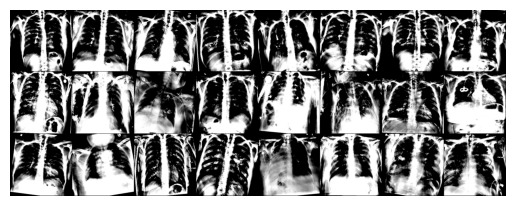

In [39]:
dataiter = iter(val_loader)
images, labels = next(dataiter)
print(labels)
print(type(images))
timshow(torchvision.utils.make_grid(images))

In [40]:
label_counts = torch.zeros(num_classes, device=device)
total_samples = 0
for batch in train_loader:
    inputs, labels = batch
    images = images.to(device)
    labels = labels.to(device)
    batch_label_counts = torch.sum(labels, dim=0).to(device)
    label_counts += batch_label_counts
    total_samples += labels.size(0)

# Calculate the weight for each label
# Avoid division by zero by adding a small epsilon
epsilon = 1e-9
label_weights = 1.0 / (torch.log(1.02 + label_counts) + epsilon)
label_weights /= label_weights.sum()
label_weights_tensor = torch.Tensor(label_weights)

In [41]:
label_counts

tensor([  159.,  1002.,  1180.,  1613.,  1761.,  1943.,  2371.,  3268.,  3713.,
         4049.,  4433.,  8094.,  9324., 13930.], device='cuda:0')

In [42]:
label_weights_tensor

tensor([0.1081, 0.0794, 0.0775, 0.0743, 0.0734, 0.0724, 0.0706, 0.0678, 0.0667,
        0.0660, 0.0653, 0.0610, 0.0600, 0.0575], device='cuda:0')

CNN model

In [44]:
curr_best_thresholds = torch.tensor([0.5] * num_classes).to(device)
curr_best_score = torch.tensor([0.0] * num_classes).to(device)
curr_best_auc = torch.tensor([0.0] * num_classes).to(device)

def optimize_threshold(val_loader, model, num_classes, opt_score_type, f1beta):
    global curr_best_score
    global curr_best_thresholds
    global curr_best_auc
    all_outputs = torch.empty((0, num_classes)).to(device)
    all_labels = torch.empty((0, num_classes)).to(device)
    with torch.no_grad():
        for images, labels in val_loader:
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            all_outputs = torch.cat((all_outputs, outputs), dim=0)
            all_labels = torch.cat((all_labels, labels), dim=0)
    auc_scores = []
    for i in range(num_classes):
        fpr, tpr, roc_thresholds = roc_curve(all_labels[:, i].cpu().numpy(), all_outputs[:, i].cpu().numpy())
        precision, recall, pr_thresholds = precision_recall_curve(all_labels[:, i].cpu().numpy(), all_outputs[:, i].cpu().numpy())

        auc_score = auc(fpr, tpr)
        auc_scores.append(auc_score)
        score = None
        thresholds = None
        if opt_score_type == "local-F1-score":
            f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
            f1_scores = np.nan_to_num(f1_scores)
            score = f1_scores
            thresholds = pr_thresholds  # Set this
        elif opt_score_type == "local-F1beta-score":
            f1_scores = (1 + f1beta**2) * precision * recall / ((1 + f1beta**2) * precision + recall + 1e-8)
            f1_scores = np.nan_to_num(f1_scores)
            score = f1_scores
            thresholds = pr_thresholds

        max_score_index = np.argmax(score[:-1])
        best_score = score[max_score_index]
        if max_score_index < len(thresholds):
            best_threshold = thresholds[max_score_index]

        # Check if both the F1 score and AUC are better than the current best scores
        if curr_best_score[i] < best_score and curr_best_auc[i] < auc_score:
            curr_best_score[i] = torch.tensor(best_score).to(device)
            curr_best_auc[i] = torch.tensor(auc_score).to(device)
            curr_best_thresholds[i] = torch.tensor(best_threshold).to(device)

    return curr_best_thresholds, curr_best_score, auc_scores


In [45]:
curr_best_thresholds

tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000], device='cuda:0')

In [46]:
def stats(loader, model, num_classes, threshold_type):
    correct = 0
    total = 0
    running_loss = 0
    n = 0
    true_positives = 0
    false_positives = 0
    false_negatives = 0
    y_true = [[] for _ in range(num_classes)]
    y_probas = [[] for _ in range(num_classes)]

    if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
        optimize_threshold(val_loader, model, num_classes, threshold_type, 0.2)
        print(curr_best_thresholds)

    with torch.no_grad():
        for data in loader:
            images, labels = data
            images = images.cuda()
            labels = labels.to(device)
            outputs = model(images)
            loss = loss_fn(outputs, labels)
            running_loss += loss.item()
            n += 1
            if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
                curr_best_thresholds_tensor = curr_best_thresholds.clone().detach().to(device)
                predicted = (outputs >= curr_best_thresholds_tensor).float()
            else:
                threshold = 0.5
                predicted = torch.where(outputs >= threshold, 1., 0.)

            total += labels.size(0)
            
            for label, output in zip(labels, outputs):
                for i in range(num_classes):
                    y_true[i].append(label[i].cpu().numpy())
                    y_probas[i].append(output[i].cpu().numpy())

            for predict, label in zip(predicted, labels):
                if (predict == label).all():
                    correct += 1
                for i, j in zip(predict, label):
                    if (i == 0 and j == 1):
                        false_negatives += 1
                    if (i == 1 and j == 0):
                        false_positives += 1
                    if (i == 1 and j == 1):
                        true_positives += 1

    test_loss = running_loss / n
    accuracy = correct / total
    precision = true_positives / (true_positives + false_positives + 1e-10)
    recall = true_positives / (true_positives + false_negatives + 1e-10)
    f1 = 2 * (precision * recall) / (precision + recall + 1e-10)
    aucs = [roc_auc_score(y_true[i], y_probas[i]) for i in range(num_classes)]
    avg_auc = sum(aucs) / num_classes
    
    return test_loss, accuracy, precision, recall, f1, avg_auc


In [47]:
def train(model,train_loader,val_loader,modle_path,stat_path,nepochs,threshold_type):
  statsrec = np.zeros((7, nepochs))
  #numiter=0
  model.train()
  for epoch in tqdm(range(nepochs)):
    correct=0
    total=0
    running_loss=0.0
    n=0
    thresholds = torch.tensor([0.5] * num_classes).to(device)
    for i, (images, labels) in enumerate(train_loader):
      images=images.to(device)
      labels = labels.to(device)
      optimizer.zero_grad()
      outputs = model(images)
      del images
      loss = loss_fn(outputs, labels)
      loss.backward()
      optimizer.step()
      
      running_loss+=loss.item()
      n+=1
      predicted=None
      total+=labels.size(0)
      if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
        curr_best_thresholds_tensor = curr_best_thresholds.clone().detach().to(device)
        predicted = (outputs >= curr_best_thresholds_tensor).float()
      else:
        threshold=0.5
        predicted = torch.where(outputs >= threshold,1., 0.)
      #print(predicted)
      #break
      if i%1000==0 and epoch>19 and epoch<21:
            print(outputs)
            print(predicted)
            #print(f'Epoch [{epoch+1}/{10}], Step [{i+1}], Loss: {loss.item():.4f}')
      for predict, label in zip(predicted, labels):
        if (predict == label).all():
            correct += 1
            #if epoch%20 == 0 :
                #print(predict)
            #print(predict)
            #print(label)
            #print("----------------------")
            #print("----------------------")
    trainloss = running_loss/n
    trainaccuracy = correct/total # train accuracy
    model.eval()
    valiloss, testaccuracy,precision, recall, f1,auc = stats(val_loader, model,num_classes,threshold_type)
    #valiloss=valiloss.cpu()
    train_loss.append(trainloss)
    test_loss.append(valiloss)
    statsrec[:,epoch] = (trainloss, trainaccuracy, valiloss, testaccuracy,precision, recall, f1)
    print(f"epoch: {epoch} training loss: {trainloss: .6f}  vali loss: {valiloss: .6f} vali auc: {auc: .3f}  vali f1: {f1: .3f} ")
    model.train()
    if epoch%3 == 0:
      torch.save(model,modle_path+str(epoch)+'epochs_mod.pt')
      torch.save({"state_dict": model.state_dict(),"stats":statsrec},stat_path+str(epoch)+'epochs_stat.pt')


In [48]:
def sample_average_accuracy(predicted, labels):
    accuracy_per_sample = (predicted == labels).sum(dim=1).float() / labels.size(1)
    average_accuracy = accuracy_per_sample.mean().item()
    return average_accuracy

## Loss Functions

In [49]:
label_weights_tensor

tensor([0.1081, 0.0794, 0.0775, 0.0743, 0.0734, 0.0724, 0.0706, 0.0678, 0.0667,
        0.0660, 0.0653, 0.0610, 0.0600, 0.0575], device='cuda:0')

In [50]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=label_weights_tensor, gamma=5):
        super(FocalLoss, self).__init__()
        self.alpha = alpha.to(device)
        self.gamma = gamma

    def forward(self, outputs, labels):
        BCE_loss = nn.BCELoss(reduction='none')(outputs, labels)
        pt = torch.exp(-BCE_loss)
        Focal_loss = self.alpha * (1-pt)**self.gamma * BCE_loss
        return Focal_loss.mean()

In [51]:
class WeightedCrossEntropyLoss(nn.Module):
    def __init__(self):
        super(WeightedCrossEntropyLoss, self).__init__()

    def forward(self, predictions, targets):
        #predictions = torch.sigmoid(predictions)
        num_pos = torch.sum(targets)
        num_neg = torch.sum(1 - targets)
        total = num_pos + num_neg

        beta_p = total / (num_pos + 1e-10)
        beta_n = total / (num_neg + 1e-10)

        epsilon = 1e-10
        positive_loss = torch.sum(-torch.log(predictions + epsilon) * targets)
        negative_loss = torch.sum(-torch.log(1 - predictions + epsilon) * (1 - targets))
        w_cel_loss = beta_p * positive_loss + beta_n * negative_loss
        num_samples = targets.size(0)
        w_cel_loss /= num_samples

        return w_cel_loss

In [52]:
class JaccardLoss(nn.Module):
    def __init__(self):
        super(JaccardLoss, self).__init__()

    def forward(self, y_pred, y_true):
        intersection = torch.sum(y_true * y_pred, dim=-1)
        union = torch.sum(y_true, dim=-1) + torch.sum(y_pred, dim=-1) - intersection
        jaccard = (intersection + 1e-8) / (union + 1e-8)
        return (1 - jaccard).mean()

In [53]:
def Hamming_Loss(y_true, y_pred):
    count = 0
    for i in range(y_true.shape[0]):
        p = np.size(y_true[i] == y_pred[i])
        q = np.count_nonzero(y_true[i] == y_pred[i])
        count += p - q
    return count / (y_true.shape[0] * y_true.shape[3])

In [54]:
#weights1 = torch.tensor([1, 1, 1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.]).to(device)

### Start Training

## model

In [55]:
class MultiLabelCNN(nn.Module):
    def __init__(self, num_classes):
        super(MultiLabelCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.relu1 = nn.ReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.relu2 = nn.ReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.relu3 = nn.ReLU()
        self.maxpool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.fc_input_size = 128 * (img_size // 8) * (img_size // 8)
        self.fc1 = nn.Linear(self.fc_input_size, 256)
        self.relu4 = nn.ReLU()
        self.fc2 = nn.Linear(256, num_classes)
        self.sigmoid = nn.Sigmoid()
        
        
    def forward(self, x):
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.maxpool1(x)
        x = self.conv2(x)
        x = self.relu2(x)
        x = self.maxpool2(x)
        x = self.conv3(x)
        x = self.relu3(x)
        x = self.maxpool3(x)
        x = x.view(x.size(0), -1)
        x = self.fc1(x)
        x = self.relu4(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        return x


In [56]:
class MultiLabelResNet(nn.Module):
    def __init__(self, num_classes):
        super(MultiLabelResNet, self).__init__()
        self.resnet = models.resnet50(pretrained=True)
        self.resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        for param in self.resnet.parameters():
            param.requires_grad = False
        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Sequential(
            nn.Linear(num_features, num_classes),
            nn.Sigmoid()
        )
    def forward(self, x):
        x = self.resnet(x)
        return x

In [57]:
class MultiLabelResNetNF(nn.Module):
    def __init__(self, num_classes):
        super(MultiLabelResNetNF, self).__init__()
        self.resnet = models.resnet50(pretrained=True)
        self.resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Sequential(
            nn.Linear(num_features, num_classes),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        x = self.resnet(x)
        return x

In [58]:
class MultiLabelDenseNet(nn.Module):
    def __init__(self, num_classes):
        super(MultiLabelDenseNet, self).__init__()
        self.densenet = models.densenet121(pretrained=True)
        self.densenet.features.conv0 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        num_features = self.densenet.classifier.in_features
        self.densenet.classifier = nn.Sequential(
            nn.Linear(num_features, num_classes),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        x = self.densenet(x)
        return x


In [59]:
import timm
class MultiLabelViT(nn.Module):
    def __init__(self, num_classes):
        super(MultiLabelViT, self).__init__()
        self.vit = timm.create_model('vit_base_patch32_384', pretrained=True)
        self.vit.patch_embed.proj = nn.Conv2d(1, self.vit.embed_dim, kernel_size=32, stride=32)
        self.vit.head = nn.Sequential(
            nn.Linear(self.vit.head.in_features, num_classes),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.vit(x)
        return x

In [60]:
class MultiTaskModel(nn.Module):
    def __init__(self, num_classes):
        super(MultiTaskModel, self).__init__()
        resnet = models.resnet50(pretrained=True)
        resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        num_ftrs = resnet.fc.in_features
        self.resnet = torch.nn.Sequential(*(list(resnet.children())[:-1]))
        self.classifiers = nn.ModuleList([nn.Linear(num_ftrs, 1) for _ in range(num_classes)])
        self.sigmoid = nn.Sigmoid()
    def forward(self, x):
        x = self.resnet(x)
        x = x.view(x.size(0), -1)  # flatten
        logits = [classifier(x) for classifier in self.classifiers]
        logits = torch.cat(logits, dim=1)
        logits = self.sigmoid(logits)
        return logits

In [65]:
class AdaptiveFPNResNet(nn.Module):
    def __init__(self, num_classes):
        super(AdaptiveFPNResNet, self).__init__()
        # Load pre-trained ResNet50
        self.resnet = models.resnet50(pretrained=False)
        self.resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        # FPN layers
        self.top_layer = nn.Sequential(
            nn.Conv2d(2048, 256, kernel_size=1, stride=1, padding=0),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        self.latent_layers = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(1024, 256, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=True)
            ),
            nn.Sequential(
                nn.Conv2d(512, 256, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=True)
            ),
            nn.Sequential(
                nn.Conv2d(256, 256, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=True)
            )
        ])
        self.upsample = nn.Upsample(scale_factor=2, mode='nearest')
        
        # Attention layers for adaptive feature fusion
        self.attention_layers = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(1024, 1, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(1),
                nn.Sigmoid()
            ),
            nn.Sequential(
                nn.Conv2d(512, 1, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(1),
                nn.Sigmoid()
            ),
            nn.Sequential(
                nn.Conv2d(256, 1, kernel_size=1, stride=1, padding=0),
                nn.BatchNorm2d(1),
                nn.Sigmoid()
            )
        ])
        
        # Classification layer
        self.classifiers = nn.ModuleList([nn.Linear(256, 1) for _ in range(num_classes)])
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Extract features from ResNet50
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)
        c1 = self.resnet.layer1(x)
        c2 = self.resnet.layer2(c1)
        c3 = self.resnet.layer3(c2)
        c4 = self.resnet.layer4(c3)
        # Build A-FPN
        p4 = self.top_layer(c4)
        p3 = self.upsample(p4) + self.latent_layers[0](c3) * self.attention_layers[0](c3)
        p2 = self.upsample(p3) + self.latent_layers[1](c2) * self.attention_layers[1](c2)
        p1 = self.upsample(p2) + self.latent_layers[2](c1) * self.attention_layers[2](c1)
        p1 = self.resnet.avgpool(p1)
        # Use p1 for classification
        x = p1.view(p1.size(0), -1)
        logits = [classifier(x) for classifier in self.classifiers]
        # Combine all outputs
        logits = torch.cat(logits, dim=1)
        logits = self.sigmoid(logits)
        
        return logits


In [61]:
print(label_counts)
print(label_weights_tensor)

tensor([  159.,  1002.,  1180.,  1613.,  1761.,  1943.,  2371.,  3268.,  3713.,
         4049.,  4433.,  8094.,  9324., 13930.], device='cuda:0')
tensor([0.1081, 0.0794, 0.0775, 0.0743, 0.0734, 0.0724, 0.0706, 0.0678, 0.0667,
        0.0660, 0.0653, 0.0610, 0.0600, 0.0575], device='cuda:0')


In [62]:
#loss_fn = nn.BCEWithLogitsLoss().to(device)
loss_fn = nn.BCELoss(weight=label_weights_tensor).to(device)
#loss_fn = nn.BCELoss().to(device)
#loss_fn = JaccardLoss().to(device)
#loss_fn = WeightedCrossEntropyLoss().to(device)
#loss_fn = nn.MultiLabelSoftMarginLoss().to(device)
#loss_fn = FocalLoss().to(device)

In [63]:
#threshold_type=""
#threshold_type="local-F1-score"
threshold_type="local-F1beta-score"
train_type=""
train_type="multi-task"

In [64]:
def lossplot(train_loss,test_loss):
    plt.plot(train_loss, label='Training Loss')
    plt.plot(test_loss, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

In [ ]:
%%time
learning_rate = 0.001
resnetmodel_epochs = 30
train_type="multi-task"
model = AdaptiveFPNResNet(num_classes).to(device)

In [78]:
#model.add_module('sigmoid', nn.Sigmoid())
optimizer=optim.Adam(model.parameters(), lr=learning_rate)
if torch.cuda.is_available():
  model.cuda()
train_loss=[]
test_loss=[]
modle_path = 'results/AdaptiveFPNResNet_classifier_'
stat_path = 'results/AdaptiveFPNResNet_classifier_'
train(model,train_loader,val_loader,modle_path,stat_path,resnetmodel_epochs,threshold_type)

  0%|          | 0/30 [00:00<?, ?it/s]

epoch: 0 training loss:  0.018060  vali loss:  0.016565 vali auc:  0.575  vali f1:  0.010 


  7%|▋         | 2/30 [02:06<29:22, 62.96s/it]

epoch: 1 training loss:  0.016351  vali loss:  0.016709 vali auc:  0.589  vali f1:  0.020 


 10%|█         | 3/30 [03:07<27:50, 61.87s/it]

epoch: 2 training loss:  0.016226  vali loss:  0.016660 vali auc:  0.615  vali f1:  0.000 
epoch: 3 training loss:  0.016238  vali loss:  0.016583 vali auc:  0.623  vali f1:  0.046 


 17%|█▋        | 5/30 [05:13<26:01, 62.45s/it]

epoch: 4 training loss:  0.016176  vali loss:  0.016697 vali auc:  0.601  vali f1:  0.005 


 20%|██        | 6/30 [06:14<24:43, 61.80s/it]

epoch: 5 training loss:  0.016110  vali loss:  0.016287 vali auc:  0.641  vali f1:  0.005 
epoch: 6 training loss:  0.016082  vali loss:  0.016407 vali auc:  0.612  vali f1:  0.005 


 27%|██▋       | 8/30 [08:20<22:48, 62.21s/it]

epoch: 7 training loss:  0.016039  vali loss:  0.016516 vali auc:  0.588  vali f1:  0.000 


 30%|███       | 9/30 [09:20<21:34, 61.62s/it]

epoch: 8 training loss:  0.015991  vali loss:  0.016520 vali auc:  0.642  vali f1:  0.017 
epoch: 9 training loss:  0.016026  vali loss:  0.016341 vali auc:  0.610  vali f1:  0.003 


 37%|███▋      | 11/30 [11:25<19:37, 61.97s/it]

epoch: 10 training loss:  0.015925  vali loss:  0.016370 vali auc:  0.647  vali f1:  0.012 


 40%|████      | 12/30 [12:26<18:29, 61.61s/it]

epoch: 11 training loss:  0.015945  vali loss:  0.016732 vali auc:  0.637  vali f1:  0.003 


 40%|████      | 12/30 [13:24<20:06, 67.01s/it]


KeyboardInterrupt: 

In [ ]:
%%time
# 定义模型超参数
learning_rate = 0.001
resnetmodel_epochs = 30
train_type="multi-task"
model = MultiTaskModel(num_classes).to(device)
#model.add_module('sigmoid', nn.Sigmoid())
optimizer=optim.Adam(model.parameters(), lr=learning_rate)
if torch.cuda.is_available():
  model.cuda()
print(torchsummary.summary(model,input_size=(1,img_size,img_size), device=device.type))
train_loss=[]
test_loss=[]
modle_path = 'resultsWbce/MultiTaskModel_classifier_'
stat_path = 'resultsWbce/MultiTaskModel_classifier_'
train(model,train_loader,val_loader,modle_path,stat_path,resnetmodel_epochs,threshold_type)

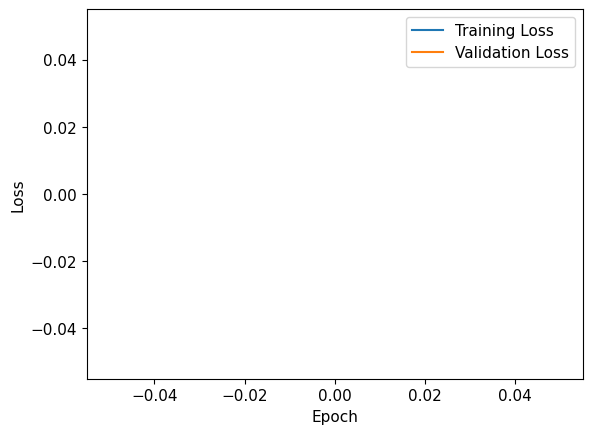

In [143]:
lossplot(train_loss,test_loss)

In [80]:
learning_rate = 0.001
model = MultiLabelCNN(num_classes).to(device)
optimizer=optim.Adam(model.parameters(), lr=learning_rate)
torchsummary.summary(model,input_size=(1,img_size,img_size), device=device.type)
train_loss=[]
test_loss=[]

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 384, 384]             320
              ReLU-2         [-1, 32, 384, 384]               0
         MaxPool2d-3         [-1, 32, 192, 192]               0
            Conv2d-4         [-1, 64, 192, 192]          18,496
              ReLU-5         [-1, 64, 192, 192]               0
         MaxPool2d-6           [-1, 64, 96, 96]               0
            Conv2d-7          [-1, 128, 96, 96]          73,856
              ReLU-8          [-1, 128, 96, 96]               0
         MaxPool2d-9          [-1, 128, 48, 48]               0
           Linear-10                  [-1, 256]      75,497,728
             ReLU-11                  [-1, 256]               0
           Linear-12                   [-1, 14]           3,598
          Sigmoid-13                   [-1, 14]               0
Total params: 75,593,998
Trainable para

In [82]:
%%time
# 定义模型超参数
cnnmodel_epochs = 25
if torch.cuda.is_available():
  model.cuda()
modle_path = 'results/MYCNN_classifier_'
stat_path = 'results/MYCNN_classifier_'
train(model,train_loader,val_loader,modle_path,stat_path,cnnmodel_epochs,threshold_type)

  0%|          | 0/25 [00:00<?, ?it/s]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 0 training loss:  0.016107  vali loss:  0.016104 vali auc:  0.675  vali f1:  0.326 


  4%|▍         | 1/25 [22:25<8:58:00, 1345.02s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


  8%|▊         | 2/25 [44:32<8:31:40, 1334.81s/it]

epoch: 1 training loss:  0.015863  vali loss:  0.016028 vali auc:  0.678  vali f1:  0.323 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 12%|█▏        | 3/25 [1:06:40<8:08:19, 1331.81s/it]

epoch: 2 training loss:  0.015683  vali loss:  0.015983 vali auc:  0.692  vali f1:  0.336 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 3 training loss:  0.015508  vali loss:  0.015956 vali auc:  0.694  vali f1:  0.334 


 16%|█▌        | 4/25 [1:29:05<7:47:55, 1336.95s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 20%|██        | 5/25 [1:51:18<7:25:05, 1335.29s/it]

epoch: 4 training loss:  0.015359  vali loss:  0.015807 vali auc:  0.704  vali f1:  0.344 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 24%|██▍       | 6/25 [2:13:33<7:02:51, 1335.34s/it]

epoch: 5 training loss:  0.015252  vali loss:  0.015834 vali auc:  0.704  vali f1:  0.335 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 6 training loss:  0.015144  vali loss:  0.015862 vali auc:  0.709  vali f1:  0.332 


 28%|██▊       | 7/25 [2:35:47<6:40:30, 1335.01s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 32%|███▏      | 8/25 [2:57:58<6:17:53, 1333.73s/it]

epoch: 7 training loss:  0.015025  vali loss:  0.015794 vali auc:  0.710  vali f1:  0.347 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 36%|███▌      | 9/25 [3:20:22<5:56:27, 1336.75s/it]

epoch: 8 training loss:  0.014948  vali loss:  0.015838 vali auc:  0.707  vali f1:  0.344 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 9 training loss:  0.014860  vali loss:  0.015855 vali auc:  0.714  vali f1:  0.346 


 40%|████      | 10/25 [3:42:54<5:35:24, 1341.64s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 44%|████▍     | 11/25 [4:05:16<5:13:02, 1341.62s/it]

epoch: 10 training loss:  0.014785  vali loss:  0.015732 vali auc:  0.712  vali f1:  0.359 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 48%|████▊     | 12/25 [4:27:35<4:50:30, 1340.84s/it]

epoch: 11 training loss:  0.014705  vali loss:  0.015766 vali auc:  0.715  vali f1:  0.358 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 12 training loss:  0.014614  vali loss:  0.015786 vali auc:  0.707  vali f1:  0.349 


 52%|█████▏    | 13/25 [4:49:59<4:28:22, 1341.86s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 56%|█████▌    | 14/25 [5:12:12<4:05:30, 1339.15s/it]

epoch: 13 training loss:  0.014578  vali loss:  0.015919 vali auc:  0.711  vali f1:  0.340 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 60%|██████    | 15/25 [5:34:26<3:42:56, 1337.68s/it]

epoch: 14 training loss:  0.014529  vali loss:  0.016129 vali auc:  0.713  vali f1:  0.350 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 15 training loss:  0.014434  vali loss:  0.016162 vali auc:  0.705  vali f1:  0.323 


 64%|██████▍   | 16/25 [5:56:50<3:20:56, 1339.58s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 68%|██████▊   | 17/25 [6:19:06<2:58:28, 1338.55s/it]

epoch: 16 training loss:  0.014374  vali loss:  0.015839 vali auc:  0.712  vali f1:  0.339 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 72%|███████▏  | 18/25 [6:41:20<2:35:59, 1337.13s/it]

epoch: 17 training loss:  0.014313  vali loss:  0.016092 vali auc:  0.710  vali f1:  0.343 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 18 training loss:  0.014240  vali loss:  0.015903 vali auc:  0.714  vali f1:  0.347 


 76%|███████▌  | 19/25 [7:03:42<2:13:51, 1338.60s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 80%|████████  | 20/25 [7:26:00<1:51:30, 1338.18s/it]

epoch: 19 training loss:  0.014217  vali loss:  0.015982 vali auc:  0.715  vali f1:  0.346 
tensor([[1.8284e-05, 4.6216e-02, 7.2244e-03, 1.5622e-01, 1.5809e-01, 4.4128e-03,
         6.7708e-02, 4.9469e-02, 2.0728e-01, 6.2219e-02, 7.8667e-02, 3.1439e-01,
         2.0155e-01, 3.7805e-01],
        [1.8660e-04, 1.0421e-02, 1.0577e-02, 8.7161e-03, 8.8387e-03, 1.1317e-02,
         2.0384e-02, 4.4393e-02, 1.0311e-02, 7.2974e-02, 1.6304e-01, 1.9607e-01,
         1.9366e-02, 4.2881e-01],
        [1.5901e-07, 1.5530e-03, 9.9220e-04, 4.4222e-05, 2.8671e-03, 2.5310e-04,
         1.2958e-02, 6.0065e-03, 2.8997e-03, 1.2908e-01, 2.7740e-01, 1.3626e-02,
         2.4246e-03, 3.9615e-01],
        [2.5772e-03, 1.1120e-02, 4.6835e-02, 3.1304e-04, 2.2527e-03, 4.1849e-04,
         7.5409e-02, 1.8525e-02, 1.9489e-03, 3.2791e-02, 8.2534e-02, 8.9684e-02,
         1.7430e-02, 3.3023e-01],
        [2.9815e-06, 3.7252e-03, 6.7812e-03, 1.9910e-04, 1.8993e-03, 4.5156e-04,
         1.8182e-02, 7.6002e-03, 3.2479e-03

 84%|████████▍ | 21/25 [7:48:19<1:29:14, 1338.52s/it]

epoch: 20 training loss:  0.014172  vali loss:  0.015929 vali auc:  0.710  vali f1:  0.344 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 21 training loss:  0.014095  vali loss:  0.016139 vali auc:  0.707  vali f1:  0.345 


 88%|████████▊ | 22/25 [8:10:47<1:07:03, 1341.29s/it]

tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 92%|█████████▏| 23/25 [8:32:59<44:36, 1338.49s/it]  

epoch: 22 training loss:  0.014062  vali loss:  0.015925 vali auc:  0.714  vali f1:  0.350 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')


 96%|█████████▌| 24/25 [8:55:29<22:22, 1342.21s/it]

epoch: 23 training loss:  0.014014  vali loss:  0.016050 vali auc:  0.713  vali f1:  0.343 
tensor([0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182], device='cuda:0')
epoch: 24 training loss:  0.013972  vali loss:  0.015893 vali auc:  0.714  vali f1:  0.344 


100%|██████████| 25/25 [9:17:57<00:00, 1339.09s/it]

CPU times: user 16h 32min 31s, sys: 8min 36s, total: 16h 41min 7s
Wall time: 9h 17min 57s


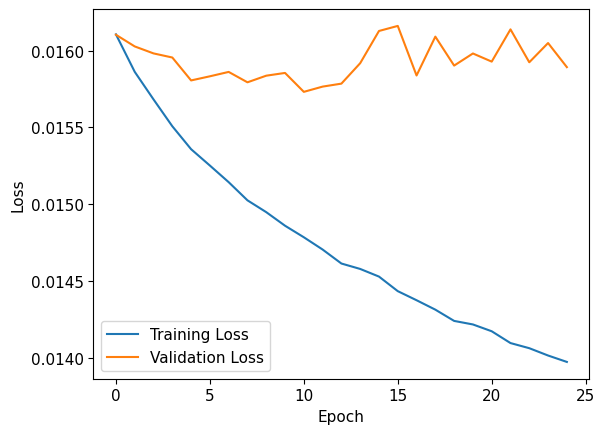

In [83]:
lossplot(train_loss,test_loss)

## ResNet Model

In [77]:
%%time
resnetmodel_epochs = 20
model = MultiLabelResNetNF(num_classes)
optimizer=optim.Adam(model.parameters(), lr=learning_rate)
if torch.cuda.is_available():
  model.cuda()
#print(torchsummary.summary(model,input_size=(1,img_size,img_size), device=device.type))
train_loss=[]
test_loss=[]
modle_path = 'results/ResNet_classifier_'
stat_path = 'results/ResNet_classifier_'
train(model,train_loader,val_loader,modle_path,stat_path,resnetmodel_epochs,threshold_type)

  0%|          | 0/20 [00:00<?, ?it/s]


KeyboardInterrupt: 

## DenseNet

In [69]:
%%time
# 定义模型超参数
resnetmodel_epochs = 30
model = MultiLabelDenseNet(num_classes)
optimizer=optim.Adam(model.parameters(), lr=learning_rate)
if torch.cuda.is_available():
  model.cuda()
#print(model)
trainloss=[]
testloss=[]

modle_path = 'results/DensNet_classifier_'
stat_path = 'results/DensNet_classifier_'
train(model,train_loader,val_loader,modle_path,stat_path,resnetmodel_epochs,threshold_type)

/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
  0%|          | 0/30 [00:00<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 82.00 MiB (GPU 0; 23.68 GiB total capacity; 22.26 GiB already allocated; 21.00 MiB free; 22.28 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

## VIT

In [69]:
%%time
learning_rate = 0.001
resnetmodel_epochs = 25
model = MultiLabelViT(num_classes)
optimizer=optim.Adam(model.parameters(), lr=learning_rate)
if torch.cuda.is_available():
  model.cuda()
#print(model)
train_loss=[]
test_loss=[]
modle_path = 'results/ViT_classifier_'
stat_path = 'results/ViT_classifier_'
train(model,train_loader,val_loader,modle_path,stat_path,resnetmodel_epochs,threshold_type)

  0%|          | 0/25 [00:00<?, ?it/s]

tensor([0.0016, 0.0247, 0.0079, 0.0392, 0.0086, 0.0206, 0.0280, 0.0652, 0.0564,
        0.0280, 0.1077, 0.1344, 0.2469, 0.2292], device='cuda:0')
epoch: 0 training loss:  0.020947  vali loss:  0.017229 vali auc:  0.570  vali f1:  0.243 


  4%|▍         | 1/25 [01:25<34:16, 85.69s/it]

tensor([0.0016, 0.0247, 0.0079, 0.0392, 0.0086, 0.0206, 0.0115, 0.0652, 0.0564,
        0.0280, 0.1077, 0.1344, 0.2469, 0.2292], device='cuda:0')


  8%|▊         | 2/25 [02:37<29:49, 77.80s/it]

epoch: 1 training loss:  0.017379  vali loss:  0.017418 vali auc:  0.555  vali f1:  0.119 
tensor([0.0016, 0.0247, 0.0079, 0.0392, 0.0086, 0.1069, 0.0115, 0.0652, 0.0564,
        0.0480, 0.1077, 0.0901, 0.2469, 0.2292], device='cuda:0')


 12%|█▏        | 3/25 [03:49<27:30, 75.03s/it]

epoch: 2 training loss:  0.017104  vali loss:  0.017854 vali auc:  0.575  vali f1:  0.186 
tensor([0.0016, 0.0143, 0.0079, 0.0392, 0.0086, 0.1127, 0.0115, 0.0652, 0.0564,
        0.0480, 0.1077, 0.0901, 0.2469, 0.2292], device='cuda:0')
epoch: 3 training loss:  0.017140  vali loss:  0.017195 vali auc:  0.553  vali f1:  0.166 


 16%|█▌        | 4/25 [05:56<31:11, 89.14s/it]


KeyboardInterrupt: 

In [ ]:
threshold1 = [0.2449, 0.0759, 0.0996, 0.2099, 0.1964, 0.1974, 0.1871, 0.1446, 0.2381,
        0.0939, 0.1852, 0.1713, 0.2890, 0.2182]
tensor_threshold1 = torch.tensor(threshold1).to(device)

optimize_threshold(val_loader, model, num_classes, threshold_type, 0.2)

In [133]:
def get_multilabel_confusion_matrix(model, model_path, loader, class_labels, title, threshold=tensor_threshold1):
    
    model = torch.load(model_path)
    if torch.cuda.is_available():
        model.cuda()
    model.eval()
    class_labels_size = len(class_labels)
    prediction = []
    actual = []
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            predicted = (outputs >= threshold).float()
            prediction.extend(predicted.cpu().numpy())
            actual.extend(labels.cpu().numpy())
    
    model_confusion_matrix = multilabel_confusion_matrix(np.array(actual), np.array(prediction))

    for i, label in enumerate(class_labels[:-1]):
        plt.figure(figsize=(5, 5))
        cmap = plt.get_cmap('Blues')
        plt.imshow(model_confusion_matrix[i], cmap)
        plt.title(f'{label}')
        
        # Annotate each cell with the specific number
        for x in range(2):
            for y in range(2):
                plt.text(y, x, model_confusion_matrix[i][x, y], ha='center', va='center', color='red',fontsize=15)
        
        plt.xticks(np.arange(2), ['False', 'True'], rotation=60,fontsize=15)
        plt.yticks(np.arange(2), ['False', 'True'],fontsize=15)
        plt.xlabel('Predicted')
        plt.ylabel('Actual')
        plt.show()

/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


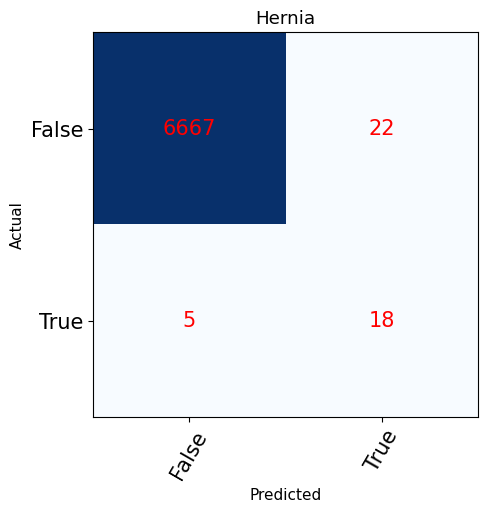

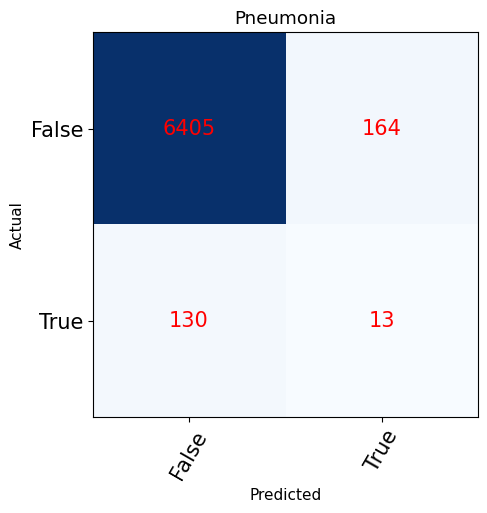

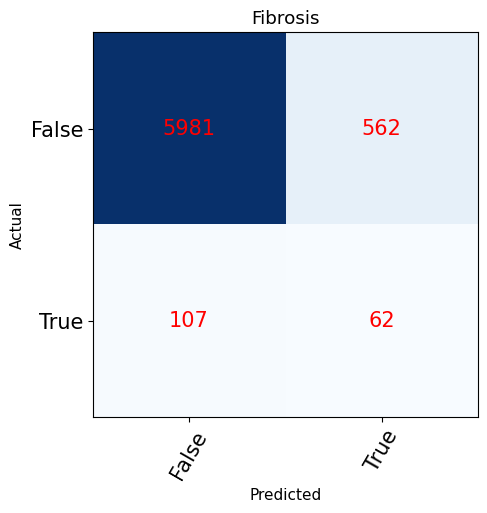

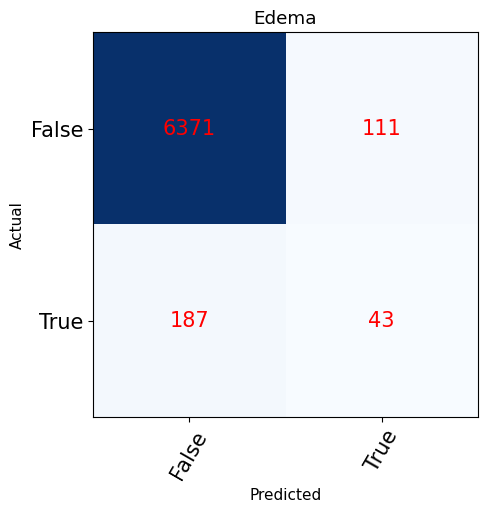

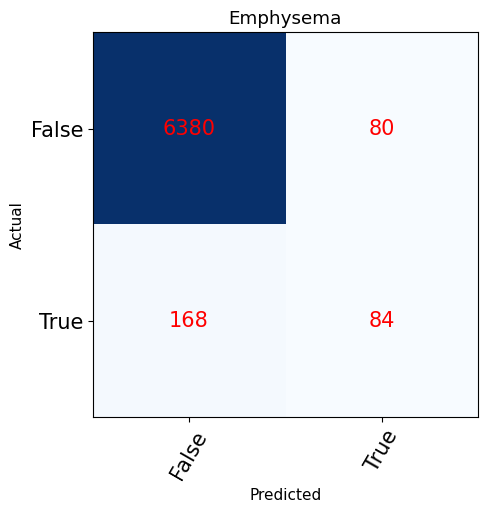

...

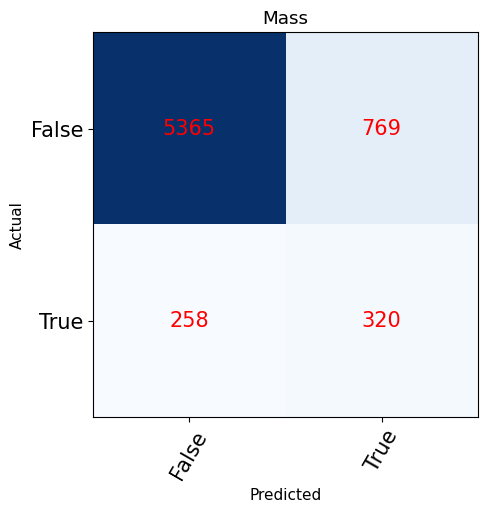

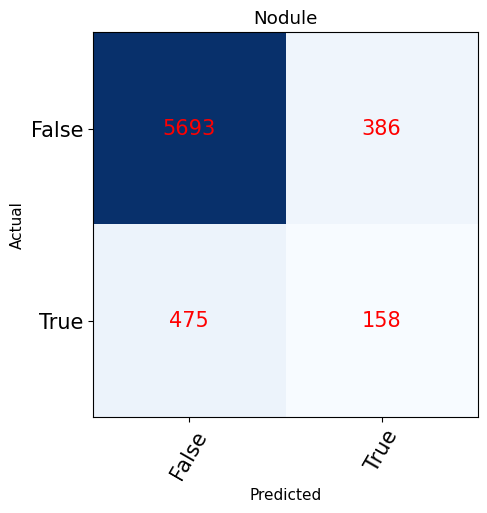

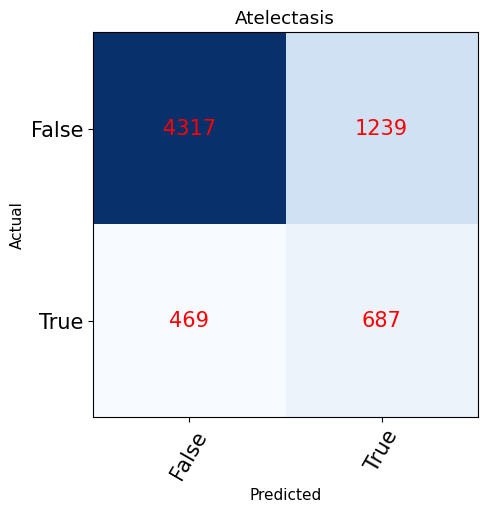

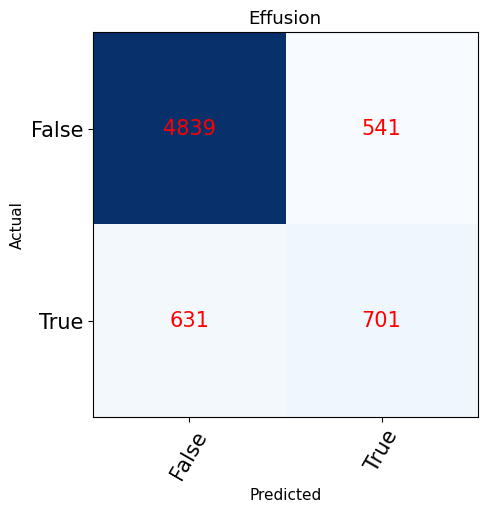

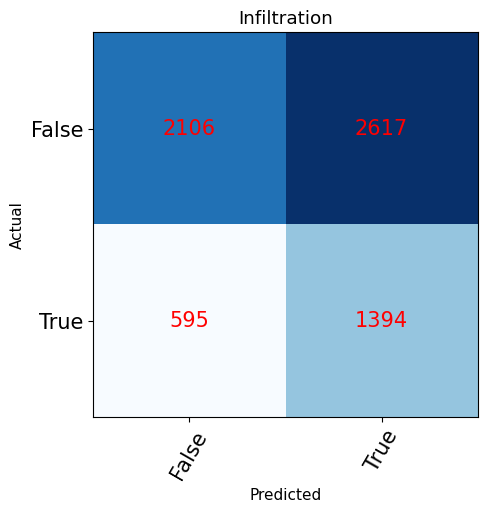

In [136]:
get_multilabel_confusion_matrix(MultiLabelDenseNet(num_classes),'results/DensNet_classifier_24epochs_mod.pt',test_loader,clables,'DensNet Validation Confusion Matrix')

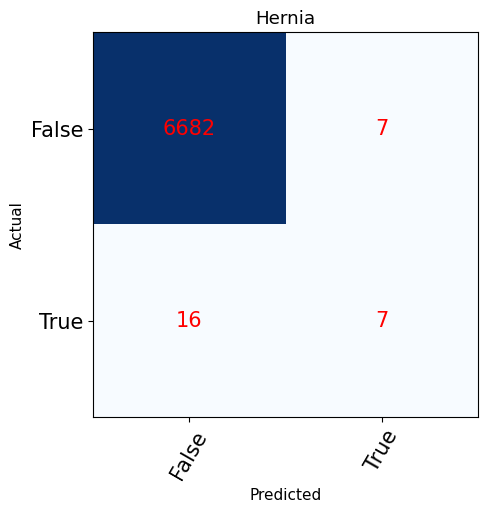

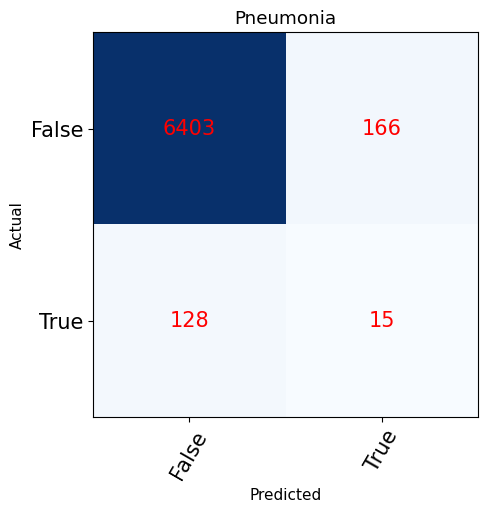

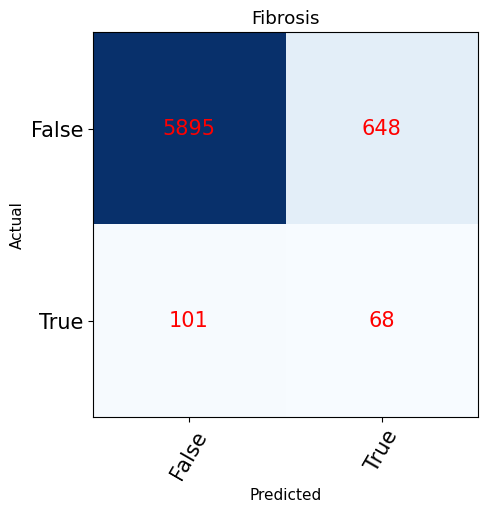

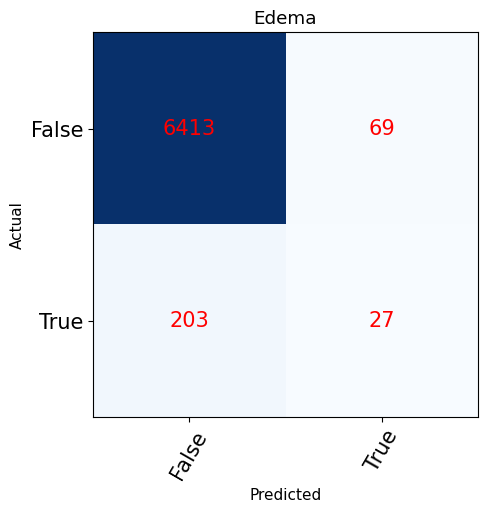

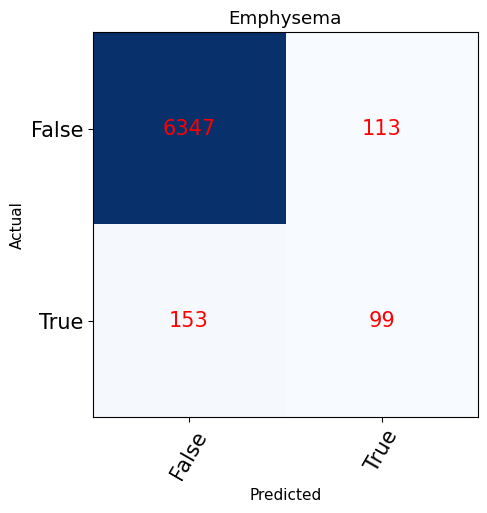

...

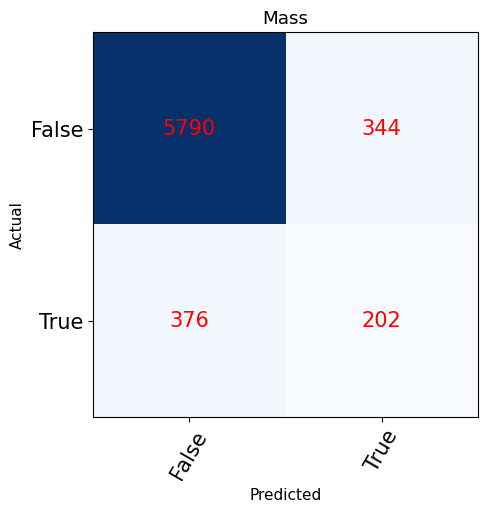

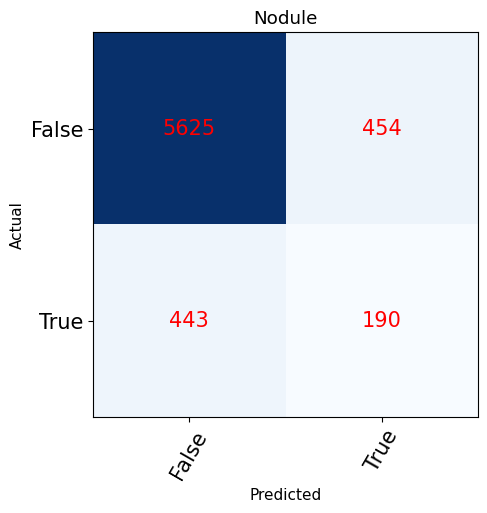

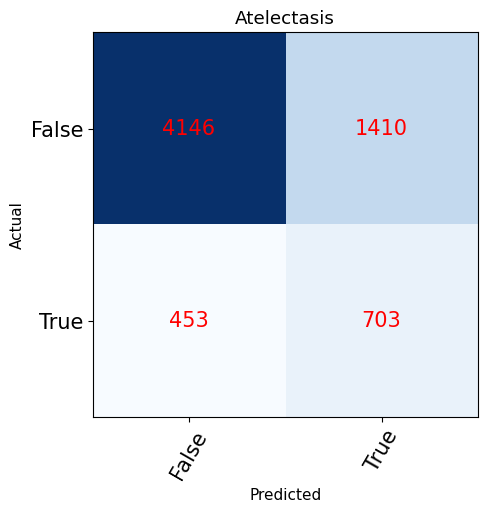

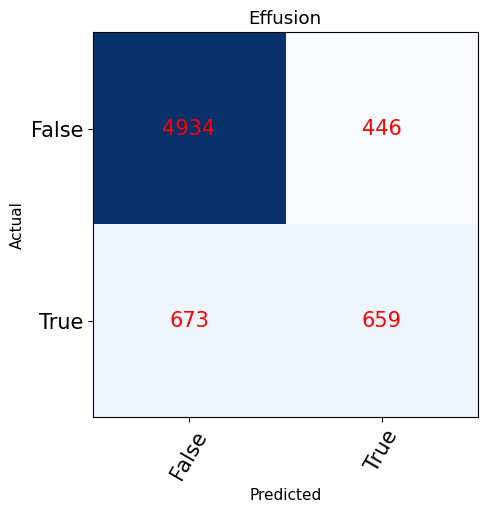

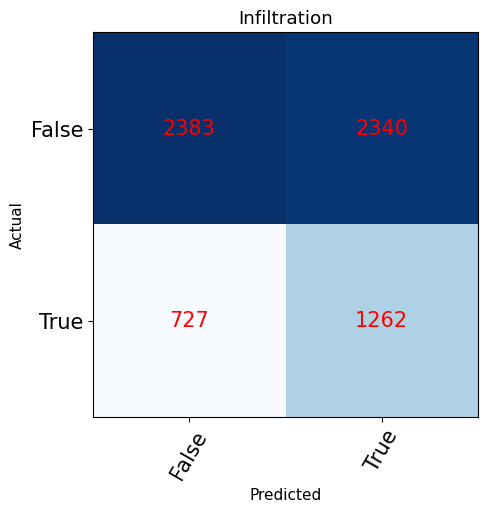

In [134]:
get_multilabel_confusion_matrix(MultiTaskModel(num_classes),'results/MultiTaskModel_classifier_24epochs_mod.pt',test_loader,clables,'DensNet Validation Confusion Matrix')

/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


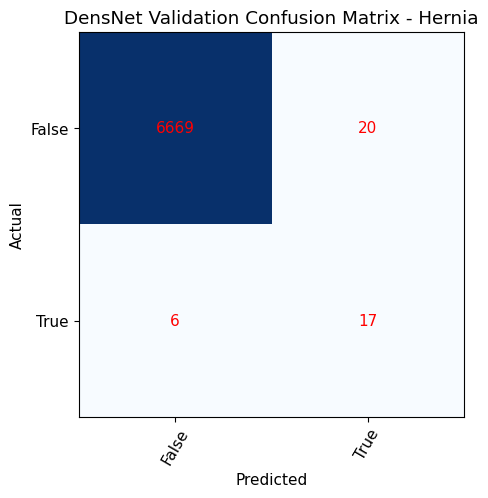

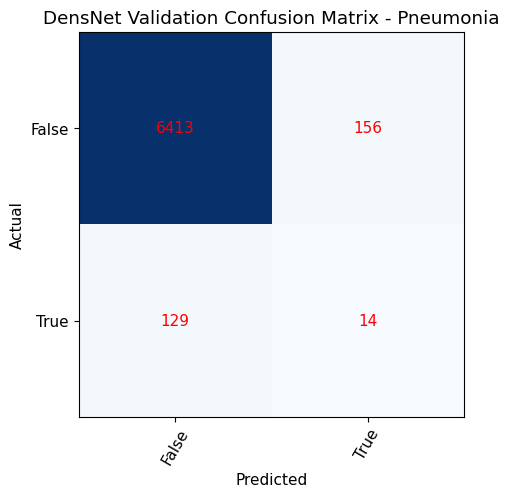

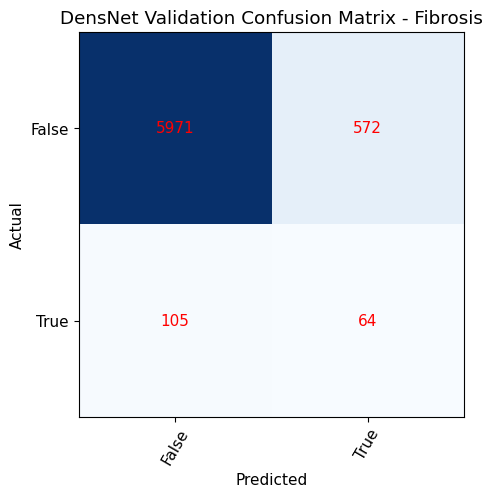

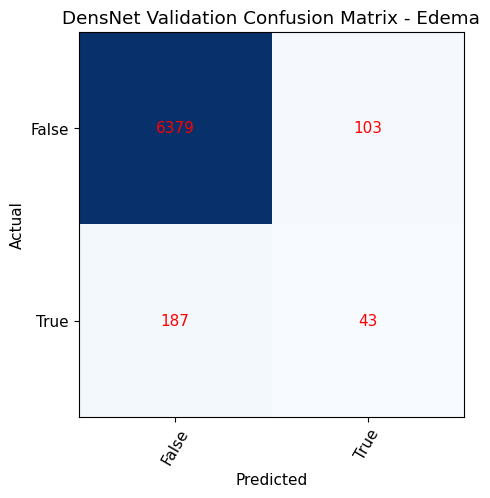

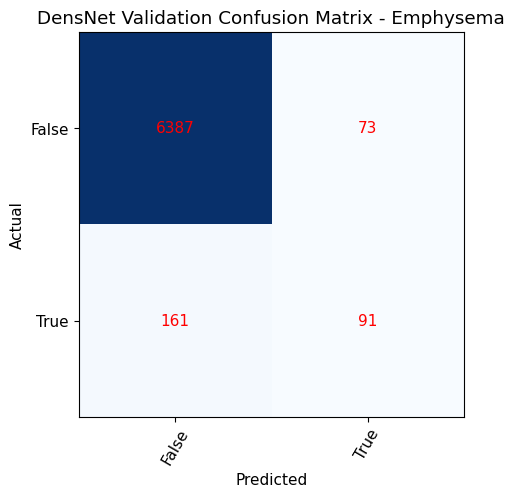

...

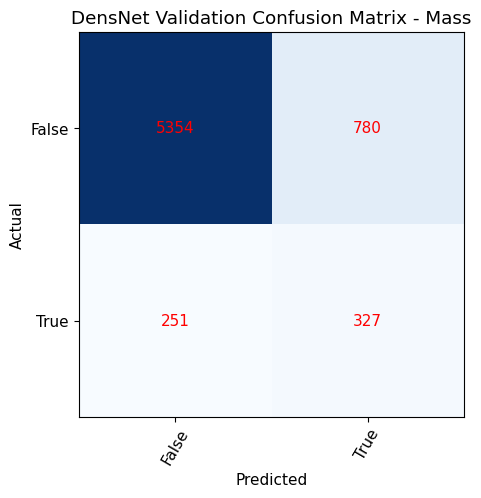

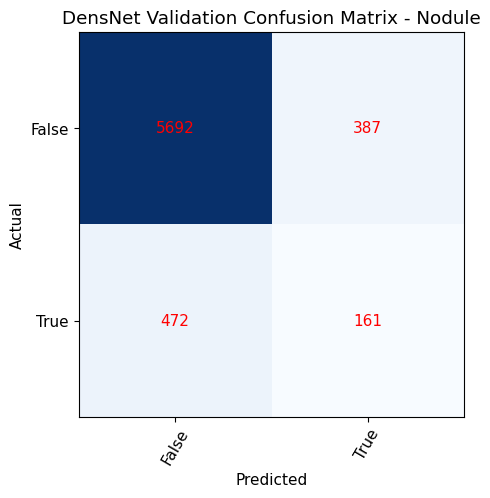

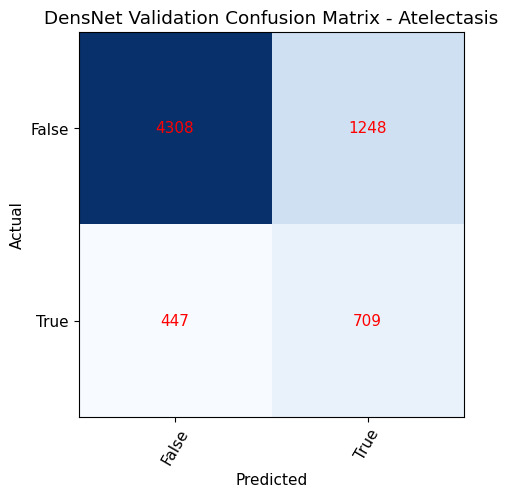

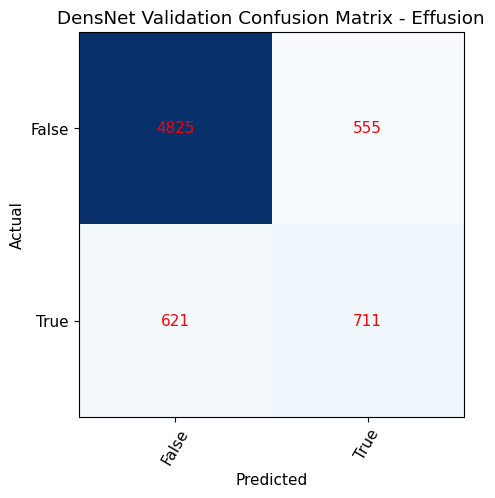

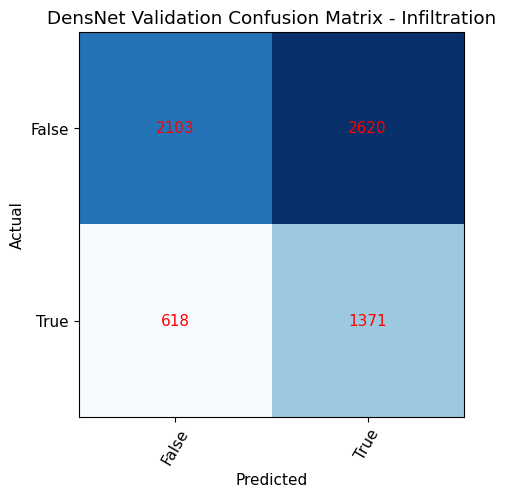

In [77]:
get_multilabel_confusion_matrix(MultiLabelDenseNet(num_classes),'results/DensNet_classifier_24epochs_mod.pt',test_load er,clables,'DensNet Validation Confusion Matrix')

In [130]:
import numpy as np
import matplotlib.pyplot as plt

def compute_cooccurrence_matrix(labels):
    class_labels_size = labels.shape[1]
    cooccurrence_matrix = np.zeros((class_labels_size, class_labels_size))
    
    for label_vector in labels:
        for i in range(class_labels_size):
            for j in range(class_labels_size):
                if label_vector[i] and label_vector[j]:
                    cooccurrence_matrix[i][j] += 1
    return cooccurrence_matrix

def visualize_cooccurrence_matrix(cooccurrence_matrix, class_labels, title):
    class_labels_size = len(class_labels) - 1
    
    fig, ax = plt.subplots(figsize=(10, 10))
    cmap = plt.get_cmap('Blues')
    im = ax.imshow(cooccurrence_matrix, cmap)
    cbar_ax = fig.add_axes([0.9, 0.2, 0.05, 0.7])
    fig.colorbar(im, cax=cbar_ax)
    ax.set_title(title, y=1.03)
    ax.set_xticks(np.arange(class_labels_size))
    ax.set_yticks(np.arange(class_labels_size))
    ax.set_xticklabels(class_labels[:-1], rotation=60, fontsize=13)
    ax.set_yticklabels(class_labels[:-1], fontsize=13)
    plt.show()


def get_label_cooccurrence_matrix(model, model_path, loader, class_labels, title, threshold=tensor_threshold1):
    
    model = torch.load(model_path)
    if torch.cuda.is_available():
        model.cuda()
    model.eval()
    prediction = []
    actual = []
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            predicted = (outputs >= threshold).float()
            prediction.extend(predicted.cpu().numpy())
            actual.extend(labels.cpu().numpy())
    
    actual_cooccurrence = compute_cooccurrence_matrix(np.array(actual))
    prediction_cooccurrence = compute_cooccurrence_matrix(np.array(prediction))
    
    visualize_cooccurrence_matrix(actual_cooccurrence, class_labels, title + ' - Actual Labels Cooccurrence Matrix')
    visualize_cooccurrence_matrix(prediction_cooccurrence, class_labels, title + ' - Predicted Labels Cooccurrence Matrix')



/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


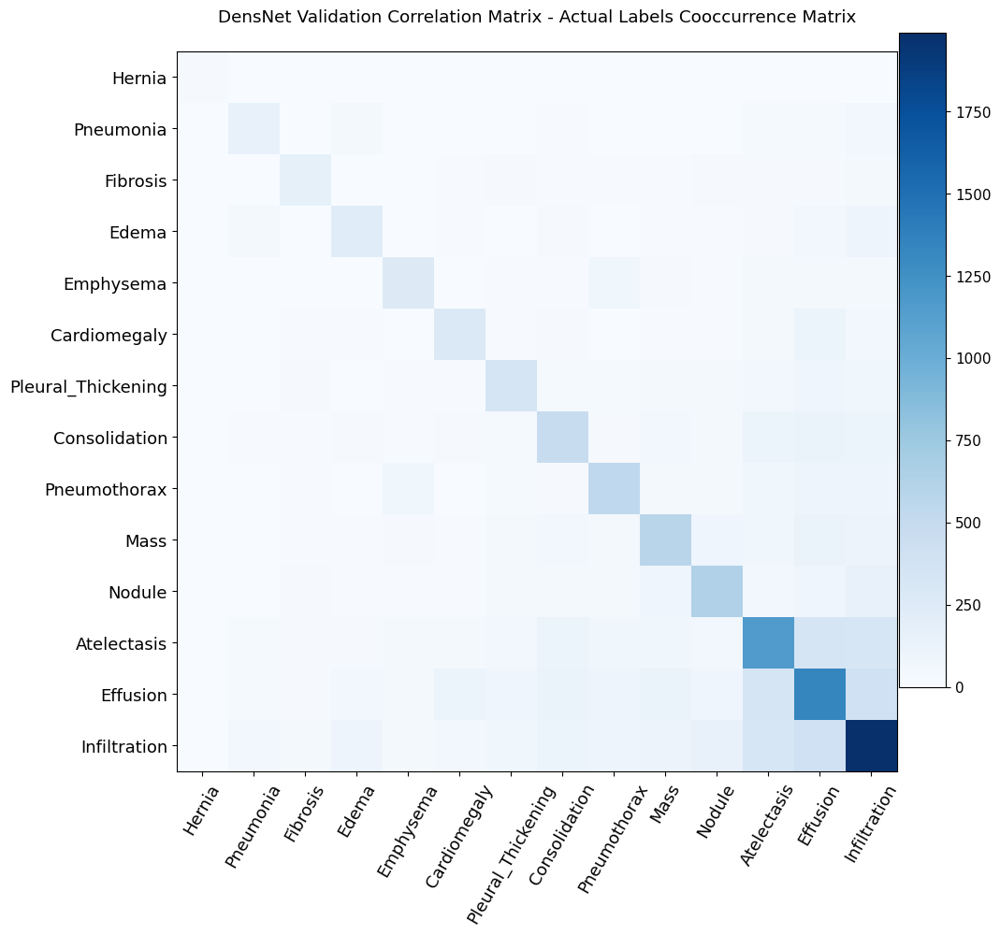

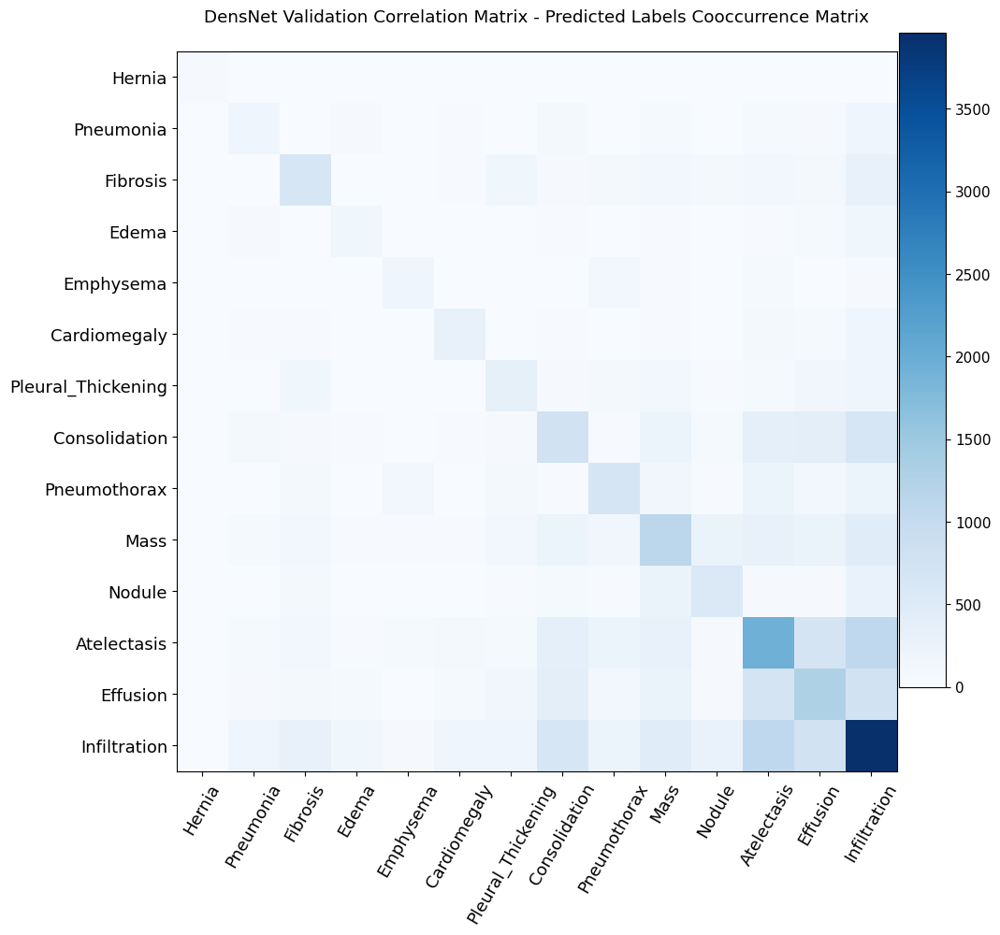

In [131]:
get_label_cooccurrence_matrix(MultiLabelDenseNet(num_classes),'results/DensNet_classifier_24epochs_mod.pt',test_loader,clables,'DensNet Validation Correlation Matrix')

/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


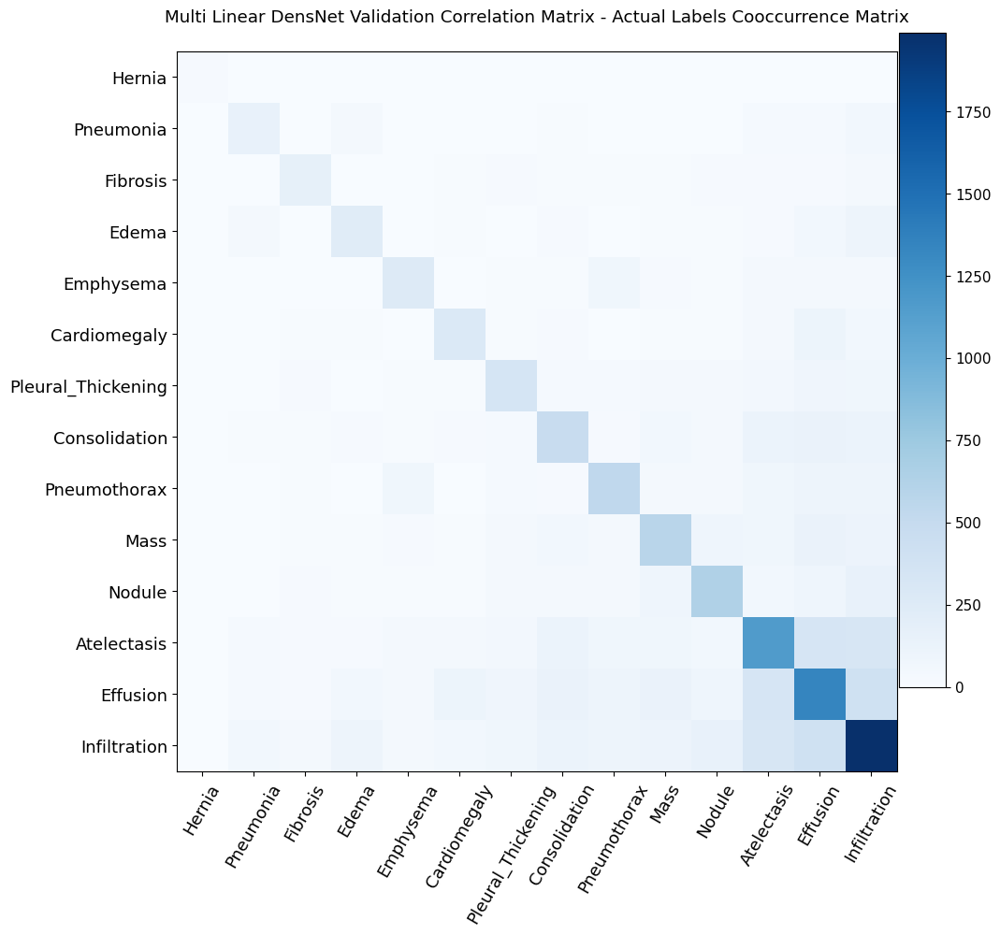

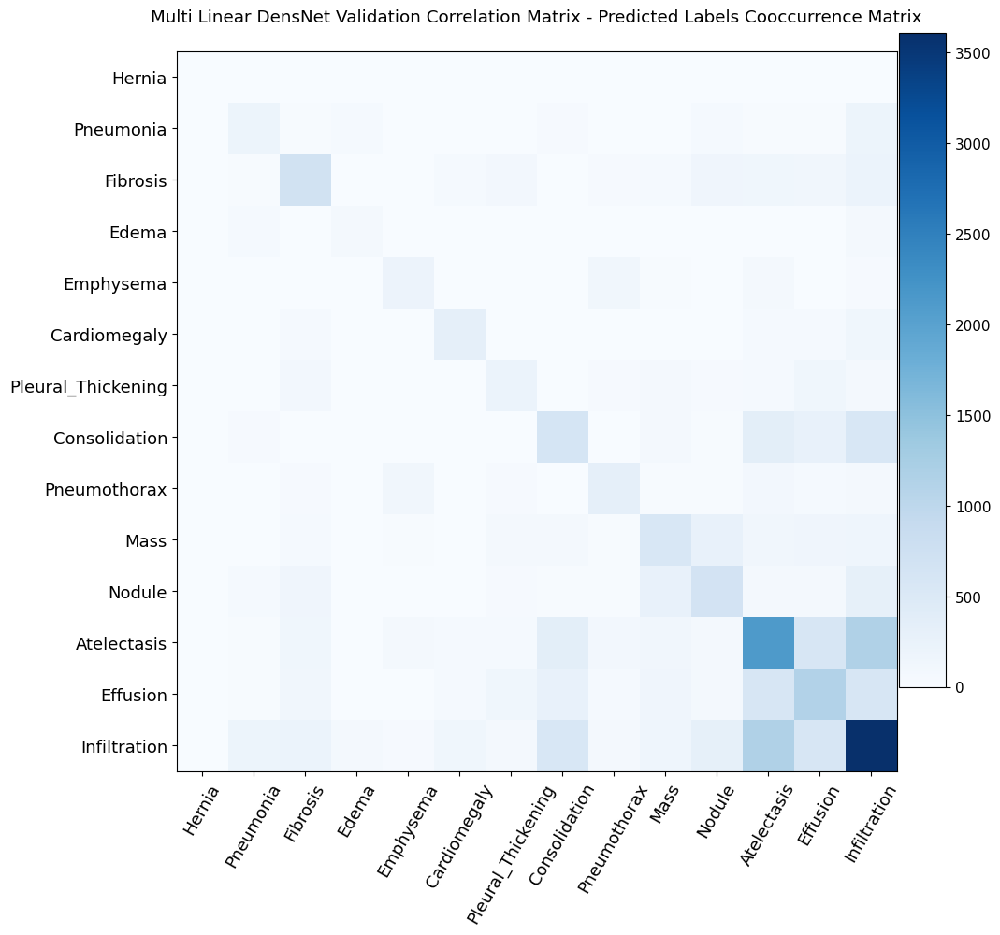

In [132]:
get_label_cooccurrence_matrix(MultiTaskModel(num_classes),'results/MultiTaskModel_classifier_24epochs_mod.pt',test_loader,clables,'Multi Linear DensNet Validation Correlation Matrix')

## There are two display_images methods below. The first module requires the prediction to be exactly the same as the actual label to be considered correct. The second display_images method is correct as long as there is an intersection between the predicted label and the actual label. ##

In [89]:
def display_images(model, model_path, loader, class_labels, threshold=0.5,num_sample=15):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    model = torch.load(model_path)
    if torch.cuda.is_available():
        model.cuda()
    model.eval()
    
    correct_images = []
    incorrect_images = []
    prediction = []
    actual = []
    correct_predicteds=[]
    incorrect_predicteds=[]
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            predicted = None
            if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
                curr_best_thresholds_tensor = curr_best_thresholds.clone().detach().to(device)
                predicted = (outputs >= curr_best_thresholds_tensor).float()
            else:
                threshold = 0.5
                predicted = torch.where(outputs >= threshold, 1., 0.)
            correct = predicted.eq(labels.byte()).all(dim=1)
            print(correct)
            for i in range(len(images)):
                if correct[i].item() == 1 and len(correct_images) < num_sample and tuple(predicted[i].cpu().numpy()) not in correct_predicteds:
                    correct_images.append((images[i],labels[i],predicted[i]))
                    correct_predicteds.append(tuple(predicted[i].cpu().numpy()))
                elif correct[i].item() == 0 and len(incorrect_images) < num_sample and tuple(predicted[i].cpu().numpy()) not in incorrect_predicteds:
                    incorrect_images.append((images[i],labels[i],predicted[i]))
                    incorrect_predicteds.append(tuple(predicted[i].cpu().numpy()))
                if len(correct_images) >= num_sample and len(incorrect_images) >= num_sample:
                    break

            if len(correct_images) >= num_sample and len(incorrect_images) >= num_sample:
                break
    
    # Display the correct images
    print("Correct Predictions:")
    for img,label,predict in correct_images:
        plt.imshow(img.cpu()[0], cmap='gray')
        plt.axis('off') 
        plt.show()
        print("True label:")
        print([clables[i] for i, value in enumerate(label) if value == 1])
        print("Predicted label:")
        print([clables[i] for i, value in enumerate(predict) if value == 1])
        print("==================")
        print("==================")

    # Display the incorrect images
    print("Incorrect Predictions:")
    for img,label,predict in incorrect_images:
        plt.imshow(img.cpu()[0], cmap='gray')
        plt.axis('off') 
        plt.show()
        print("True label:")
        print([clables[i] for i, value in enumerate(label) if value == 1])
        print("Predicted label:")
        print([clables[i] for i, value in enumerate(predict) if value == 1])
        print("==================")
        print("==================")
        
    return correct_images , incorrect_images

In [88]:
def display_images(model, model_path, loader, class_labels, threshold=0.5,num_sample=15):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    model = torch.load(model_path)
    if torch.cuda.is_available():
        model.cuda()
    model.eval()
    
    correct_images = []
    incorrect_images = []
    prediction = []
    actual = []
    correct_predicteds=[]
    incorrect_predicteds=[]
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            predicted = None
            if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
                curr_best_thresholds_tensor = curr_best_thresholds.clone().detach ().to(device)
                predicted = (outputs >= curr_best_thresholds_tensor).float()
            else:
                threshold = 0.5
                predicted = torch.where(outputs >= threshold, 1., 0.)
            labels = labels.int()
            predicted = predicted.int()
            intersection = predicted & labels
            correct = intersection.any(dim=1)
            for i in range(len(images)):
                if correct[i].item() == 1 and len(correct_images) < num_sample and tuple(predicted[i].cpu().numpy()) not in correct_predicteds:
                    correct_images.append((images[i],labels[i],predicted[i]))
                    correct_predicteds.append(tuple(predicted[i].cpu().numpy()))
                elif correct[i].item() == 0 and len(incorrect_images) < num_sample and tuple(predicted[i].cpu().numpy()) not in incorrect_predicteds:
                    incorrect_images.append((images[i],labels[i],predicted[i]))
                    incorrect_predicteds.append(tuple(predicted[i].cpu().numpy()))
                if len(correct_images) >= num_sample and len(incorrect_images) >= num_sample:
                    break

            if len(correct_images) >= num_sample and len(incorrect_images) >= num_sample:
                break
    
    # Display the correct images
    print("Correct Predictions:")
    for img,label,predict in correct_images:
        plt.imshow(img.cpu()[0], cmap='gray')
        plt.axis('off') 
        plt.show()
        print("True label:")
        print([clables[i] for i, value in enumerate(label) if value == 1])
        print("Predicted label:")
        print([clables[i] for i, value in enumerate(predict) if value == 1])
        print("==================")
        print("==================")

    # Display the incorrect images
    print("Incorrect Predictions:")
    for img,label,predict in incorrect_images:
        plt.imshow(img.cpu()[0], cmap='gray')
        plt.axis('off') 
        plt.show()
        print("True label:")
        print([clables[i] for i, value in enumerate(label) if value == 1])
        print("Predicted label:")
        print([clables[i] for i, value in enumerate(predict) if value == 1])
        print("==================")
        print("==================")
        
    return correct_images , incorrect_images

Correct Predictions:


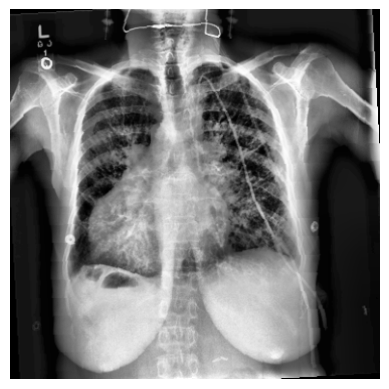

True label:
['Fibrosis', 'Cardiomegaly', 'Infiltration']
Predicted label:
['Cardiomegaly']


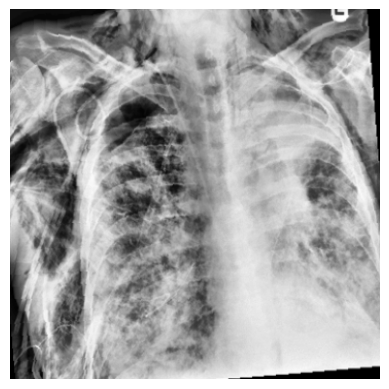

True label:
['Edema', 'Emphysema', 'Pneumothorax']
Predicted label:
['Emphysema']


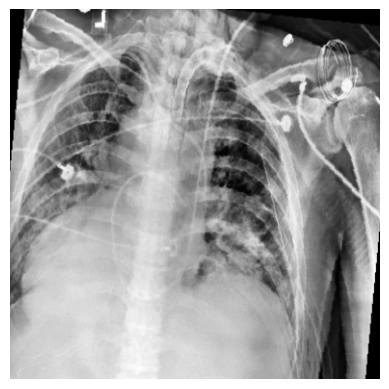

True label:
['Infiltration']
Predicted label:
['Infiltration']


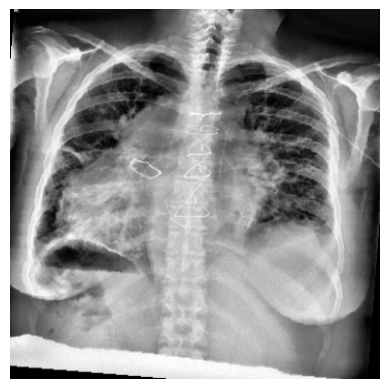

True label:
['Cardiomegaly', 'Effusion', 'Infiltration']
Predicted label:
['Cardiomegaly', 'Effusion']


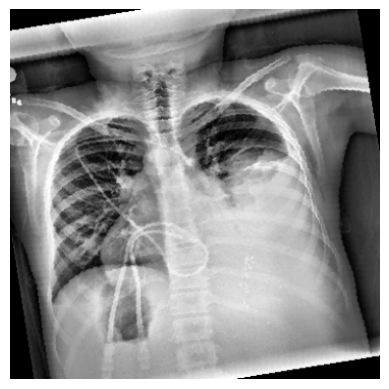

True label:
['Effusion']
Predicted label:
['Effusion']
Incorrect Predictions:


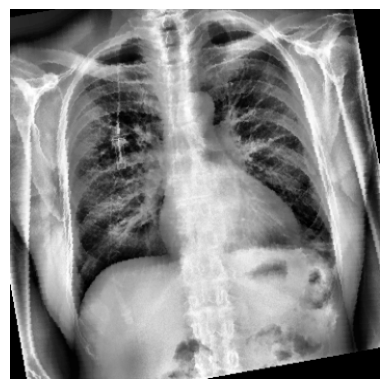

True label:
['Fibrosis', 'Nodule', 'Infiltration']
Predicted label:
[]


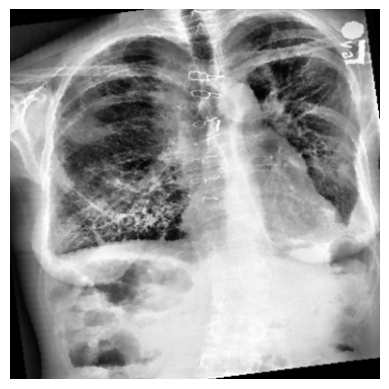

True label:
['Pleural_Thickening']
Predicted label:
['Effusion']


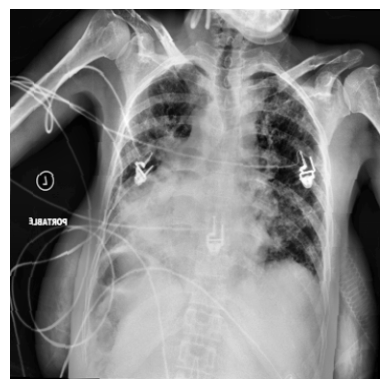

True label:
['Effusion']
Predicted label:
['Infiltration']


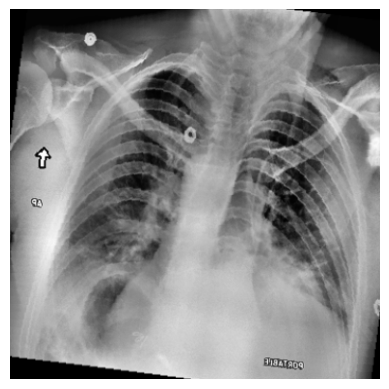

True label:
['Infiltration']
Predicted label:
['Atelectasis']


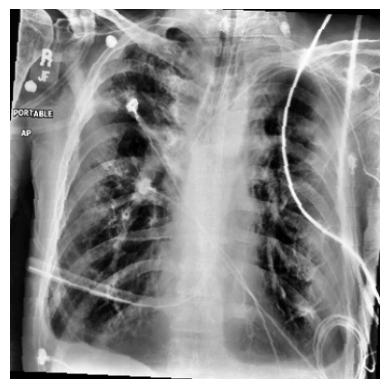

True label:
['Fibrosis', 'Effusion', 'Infiltration']
Predicted label:
['Pneumothorax']


In [77]:
MultiTaskModel_correct_images , MultiTaskModel_incorrect_images = display_images(MultiTaskModel(num_classes),'results/MultiTaskModel_classifier_24epochs_mod.pt',test_loader,clables,num_sample=5)

Correct Predictions:


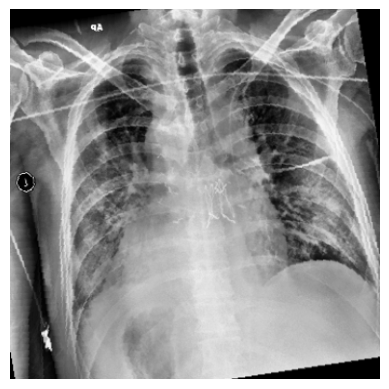

True label:
['Infiltration']
Predicted label:
['Infiltration']


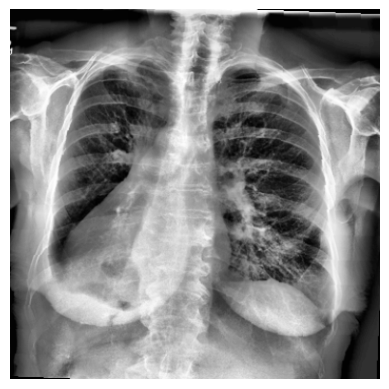

True label:
['Cardiomegaly', 'Pleural_Thickening', 'Effusion']
Predicted label:
['Effusion']


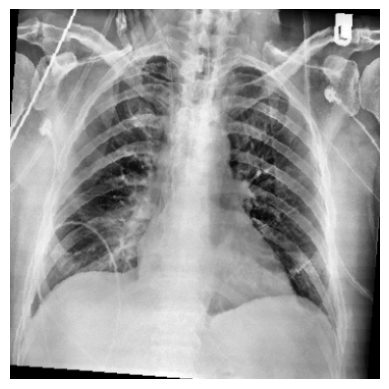

True label:
['Atelectasis', 'Effusion', 'Infiltration']
Predicted label:
['Atelectasis']


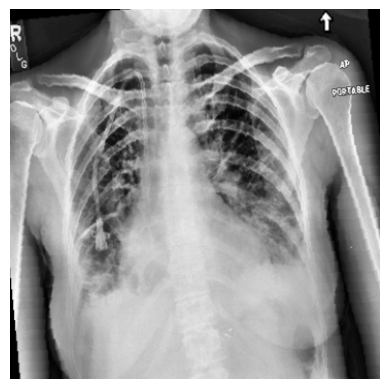

True label:
['Edema', 'Mass', 'Effusion']
Predicted label:
['Edema', 'Effusion']


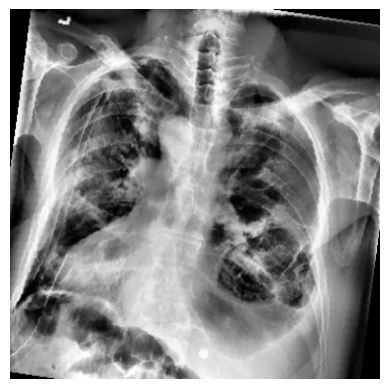

True label:
['Pneumothorax']
Predicted label:
['Pneumothorax']
Incorrect Predictions:


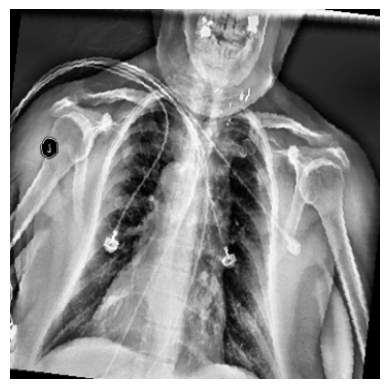

True label:
['Infiltration']
Predicted label:
[]


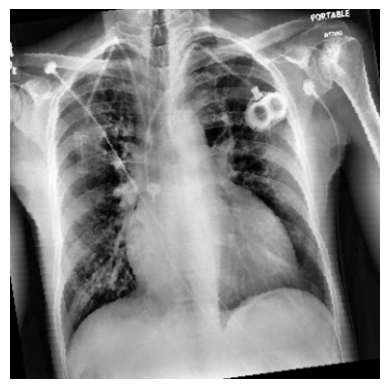

True label:
['Infiltration']
Predicted label:
['Cardiomegaly']


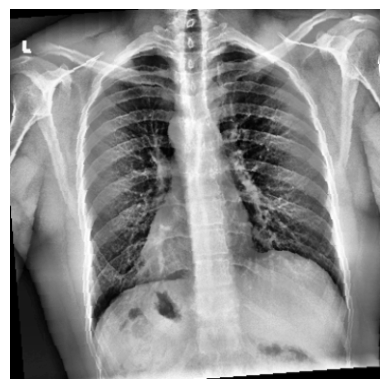

True label:
[]
Predicted label:
['Infiltration']


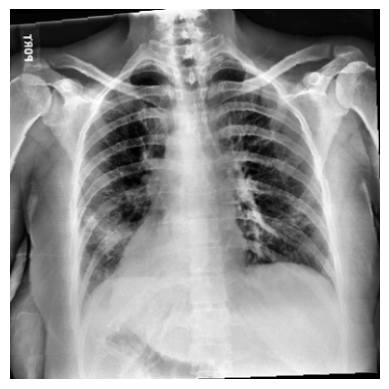

True label:
['Atelectasis', 'Infiltration']
Predicted label:
['Effusion']


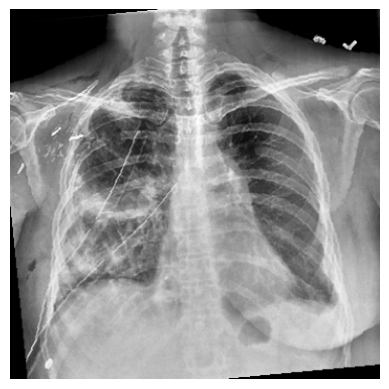

True label:
['Consolidation', 'Effusion']
Predicted label:
['Pneumothorax']


In [78]:
MultiLabelDenseNet_correct_images , MultiLabelDenseNet_incorrect_images = display_images(MultiLabelDenseNet(num_classes),'results/MYCNN_classifier_24epochs_mod.pt',test_loader,clables,num_sample=5)

In [72]:
print(MultiLabelCNN(num_classes))

MultiLabelCNN(
  (conv1): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu1): ReLU()
  (maxpool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu2): ReLU()
  (maxpool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu3): ReLU()
  (maxpool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=294912, out_features=256, bias=True)
  (relu4): ReLU()
  (fc2): Linear(in_features=256, out_features=14, bias=True)
  (sigmoid): Sigmoid()
)


In [74]:
from scipy.ndimage import zoom
def display_gradcam(model, modellayer, image, class_labels, threshold_type):
    def hook_function(module, grad_in, grad_out):
        module.saved_grad_out = grad_out
        return grad_in

    def forward_hook_function(module, input, output):
        module.output = output

    modellayer.register_forward_hook(forward_hook_function)
    hook = modellayer.register_backward_hook(hook_function)

    input_image = image.to(device)
    plt.imshow(input_image.squeeze().cpu().numpy().squeeze(), cmap='gray')
    plt.axis('off')
    plt.show()
    outputs = model(input_image)

    predicted = None
    if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
        curr_best_thresholds_tensor = curr_best_thresholds.clone().detach().to(device)
        predicted = (outputs >= curr_best_thresholds_tensor).float()
    else:
        threshold = 0.5
        predicted = torch.where(outputs >= threshold, 1., 0.)

    labels = (predicted == 1).nonzero(as_tuple=True)[1].tolist()
    result = [class_labels[i] for i in labels]
    print(result)

    for label in labels:
        model.zero_grad()
        class_score = outputs[0, label]
        class_score.backward(retain_graph=True)
        gradients = modellayer.saved_grad_out[0]
        pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])

        with torch.no_grad():
            activations = modellayer.output.clone()  # Clone to avoid in-place modification
            num_channels = activations.shape[1]
            for i in range(num_channels):
                activations[:, i, :, :] *= pooled_gradients[i]
            heatmap = torch.mean(activations, dim=1).squeeze()
            heatmap = np.maximum(heatmap.cpu().numpy(), 0)
            max_value = np.max(heatmap)
            if max_value == 0:
                print("Warning: maximum value in heatmap is 0.")
            else:
                heatmap /= max_value
            height, width = input_image.squeeze().cpu().numpy().squeeze().shape
            # Resize the heatmap to match the origional image's dimensions
            heatmap_resized = zoom(heatmap, (height / heatmap.shape[0], width / heatmap.shape[1]))
             # Display the original image
            plt.imshow(input_image.squeeze().cpu().numpy().squeeze(), cmap='gray')
            # Display the heatmap on top of the original image
            #plt.imshow(heatmap_resized.squeeze(), cmap='viridis', alpha=0.5)
            plt.imshow(heatmap_resized.squeeze(), cmap='jet', alpha=0.5)
            plt.colorbar()
            plt.axis('off')
            plt.show()
    hook.remove()  # Remove the hook after the loop


In [74]:
image_path = ROOT+"images_004/images/00006585_009.png"
image = Image.open(image_path).convert('L')
plt.imshow(image, cmap='gray')
plt.axis('off') 
plt.show()
image = transform(image).unsqueeze(0).to(device)
model = MultiLabelCNN(num_classes)
state_dict = torch.load('results/MYCNN_classifier_15epochs_stat.pt', map_location=device)["state_dict"]
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
modellayer = model.conv3
#target_layer = MultiLabelDenseNet(num_classes).densenet.features.denseblock4.denselayer16.conv2
display_gradcam(model,modellayer, image, clables,threshold_type)

FileNotFoundError: [Errno 2] No such file or directory: 'sample/images_004/images/00006585_009.png'

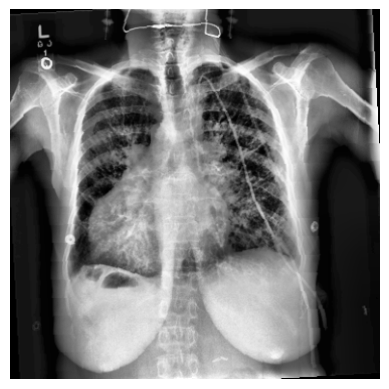

['Cardiomegaly']


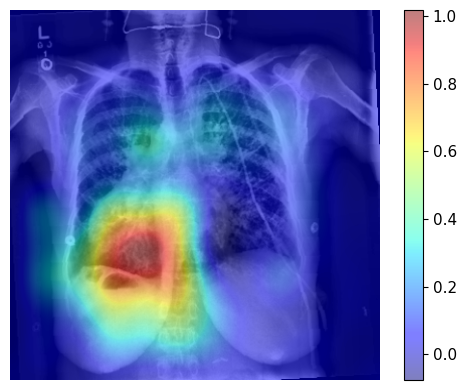

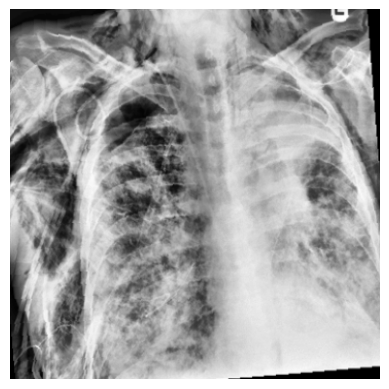

['Emphysema']


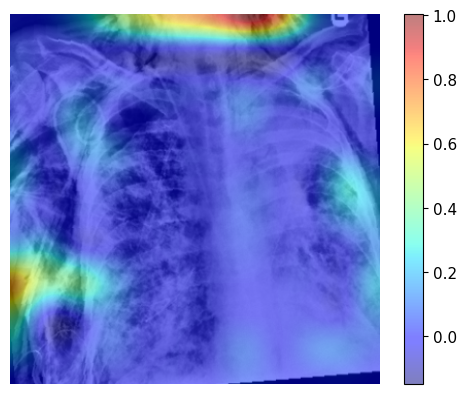

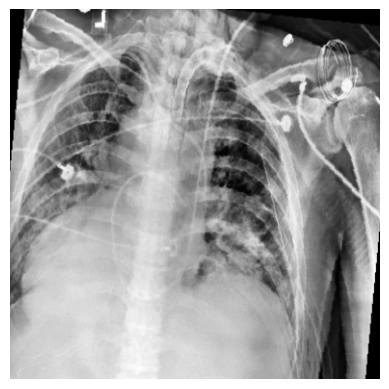

['Infiltration']


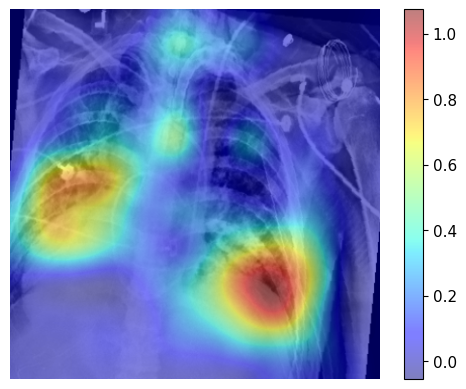

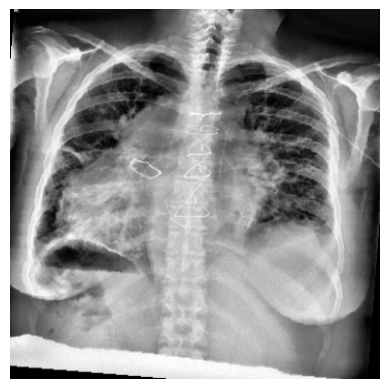

['Cardiomegaly', 'Effusion']


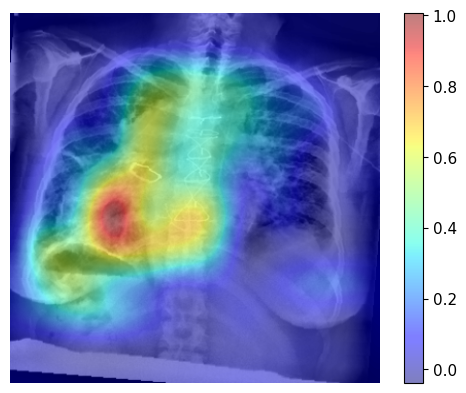

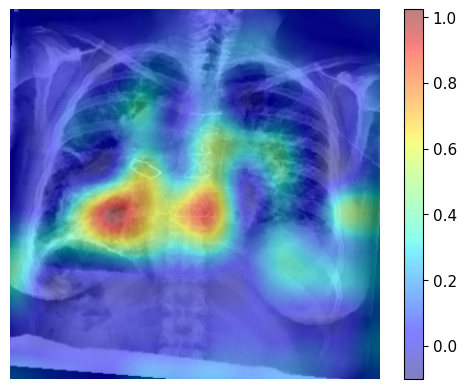

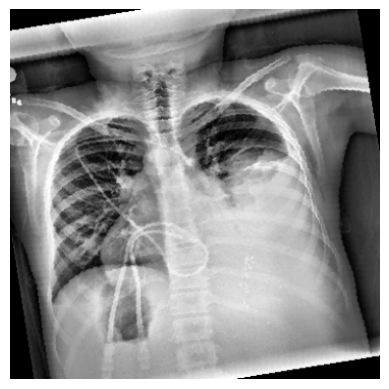

['Effusion']


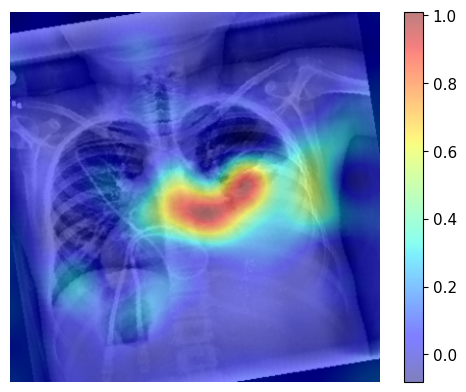

In [79]:
model = MultiTaskModel(num_classes)
state_dict = torch.load('results/MultiTaskModel_classifier_24epochs_stat.pt', map_location=device)["state_dict"]
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
modellayer = model.resnet[7][2].conv3
#target_layer = MultiLabelDenseNet(num_classes).densenet.features.denseblock4.denselayer16.conv2
for img,label,predict in MultiTaskModel_correct_images:
        img = img.unsqueeze(0)
        print(label)
        display_gradcam(model,modellayer, img, clables,threshold_type)


tensor([False, False,  True, False,  True,  True,  True, False,  True, False,
        False, False,  True, False,  True, False, False,  True, False,  True,
         True, False, False, False], device='cuda:0')
tensor([False, False,  True,  True,  True,  True, False, False,  True,  True,
         True, False, False, False,  True,  True, False, False, False, False,
        False, False, False,  True], device='cuda:0')
tensor([False, False, False,  True,  True, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,  True,
        False,  True,  True, False], device='cuda:0')
tensor([ True, False,  True, False,  True,  True, False,  True,  True, False,
         True, False, False, False,  True, False,  True, False, False, False,
        False, False, False, False], device='cuda:0')
tensor([ True, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False,  True, False, False, False,  True,
    

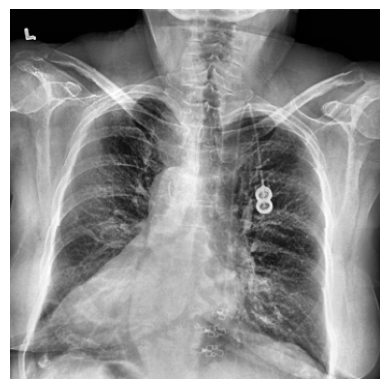

True label:
[]
Predicted label:
[]


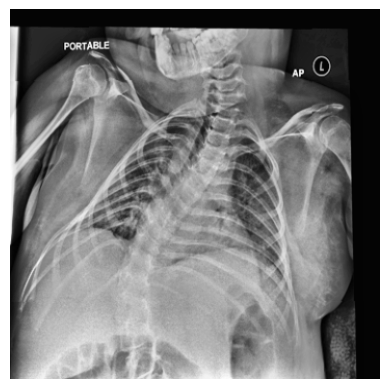

True label:
['Infiltration']
Predicted label:
['Infiltration']


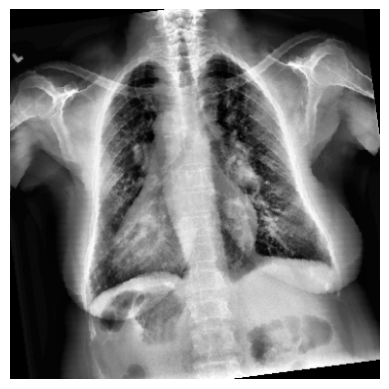

True label:
['Cardiomegaly']
Predicted label:
['Cardiomegaly']


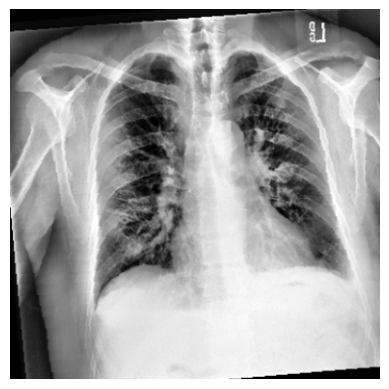

True label:
['Effusion']
Predicted label:
['Effusion']


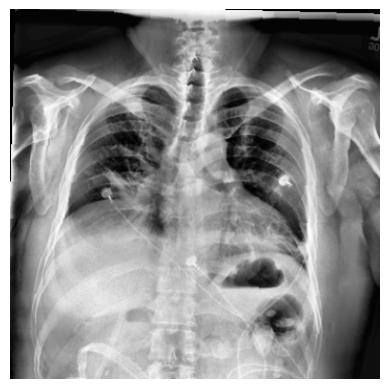

True label:
['Atelectasis']
Predicted label:
['Atelectasis']


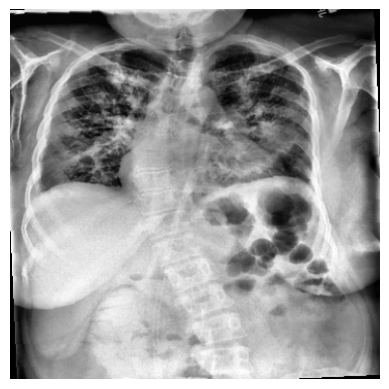

True label:
['Effusion', 'Infiltration']
Predicted label:
['Effusion', 'Infiltration']


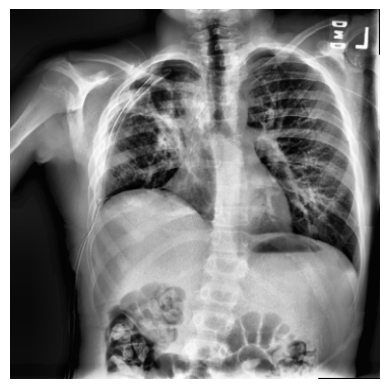

True label:
['Pneumothorax']
Predicted label:
['Pneumothorax']


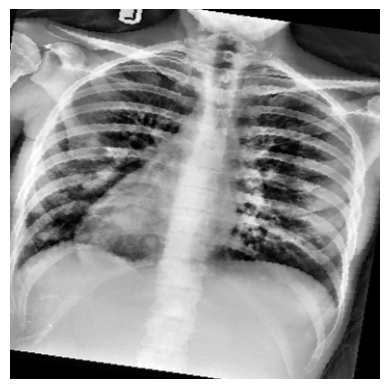

True label:
['Nodule']
Predicted label:
['Nodule']


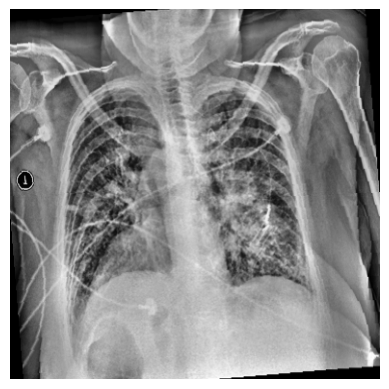

True label:
['Edema', 'Infiltration']
Predicted label:
['Edema', 'Infiltration']


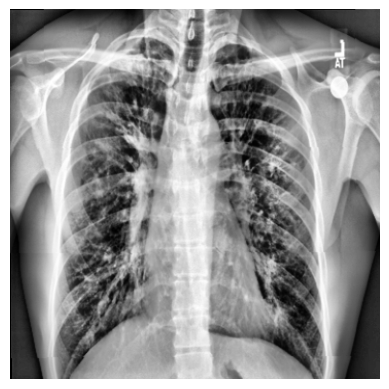

True label:
['Fibrosis']
Predicted label:
['Fibrosis']


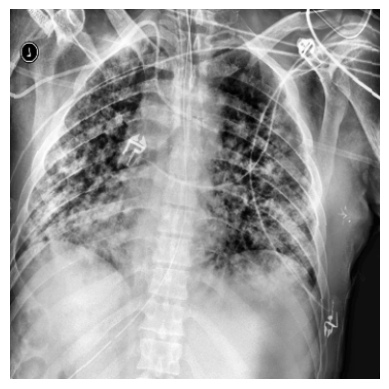

True label:
['Nodule', 'Infiltration']
Predicted label:
['Nodule', 'Infiltration']


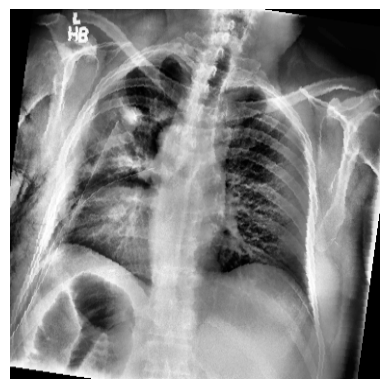

True label:
['Emphysema', 'Pneumothorax']
Predicted label:
['Emphysema', 'Pneumothorax']


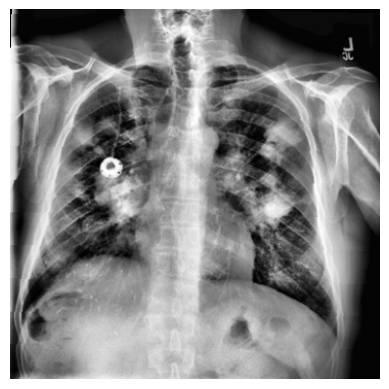

True label:
['Mass', 'Nodule']
Predicted label:
['Mass', 'Nodule']


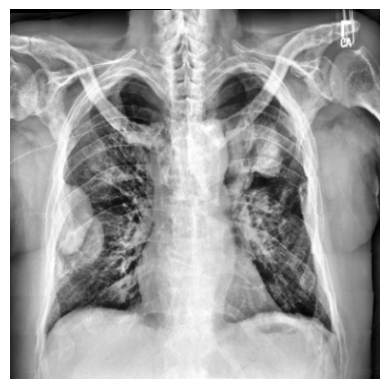

True label:
['Mass']
Predicted label:
['Mass']


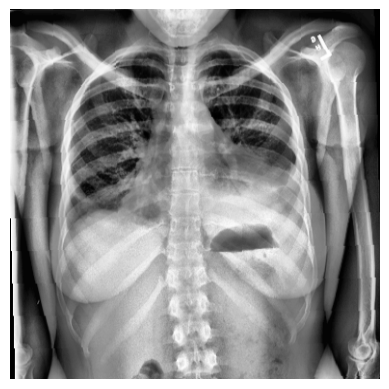

True label:
['Atelectasis', 'Effusion']
Predicted label:
['Atelectasis', 'Effusion']
Incorrect Predictions:


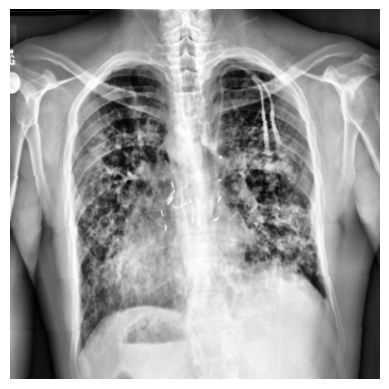

True label:
['Fibrosis']
Predicted label:
[]


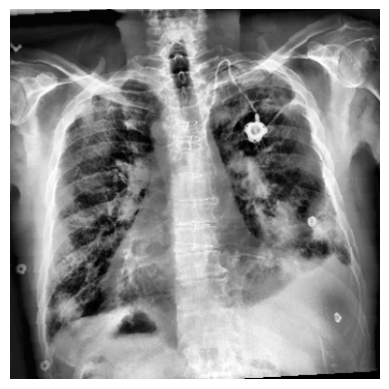

True label:
['Effusion']
Predicted label:
['Mass']


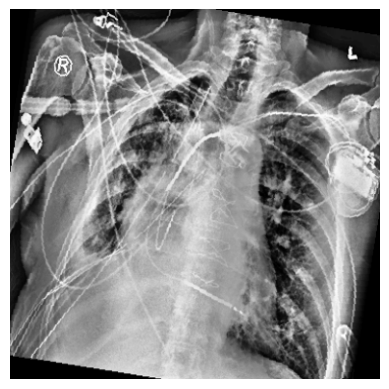

True label:
['Pneumonia', 'Pneumothorax', 'Effusion']
Predicted label:
['Infiltration']


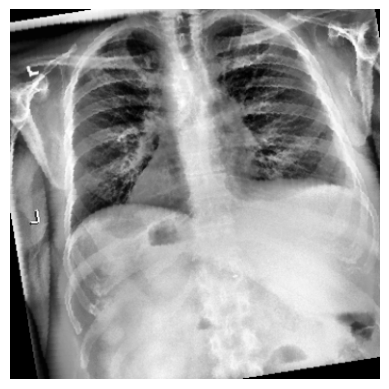

True label:
['Effusion', 'Infiltration']
Predicted label:
['Effusion']


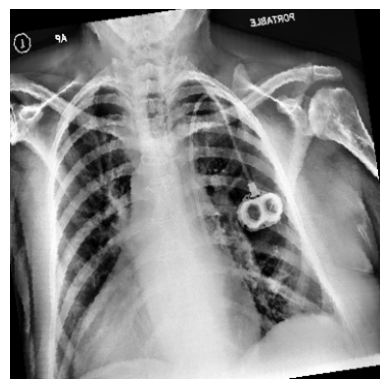

True label:
['Pneumonia', 'Cardiomegaly', 'Effusion']
Predicted label:
['Cardiomegaly']


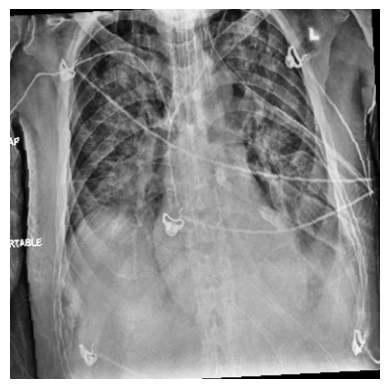

True label:
[]
Predicted label:
['Effusion', 'Infiltration']


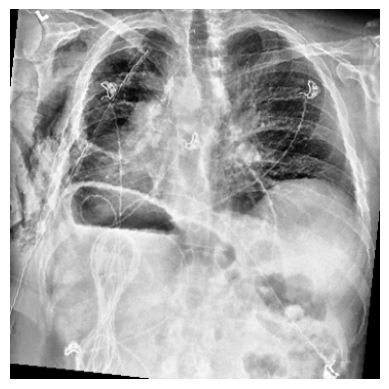

True label:
['Emphysema']
Predicted label:
['Emphysema', 'Pneumothorax']


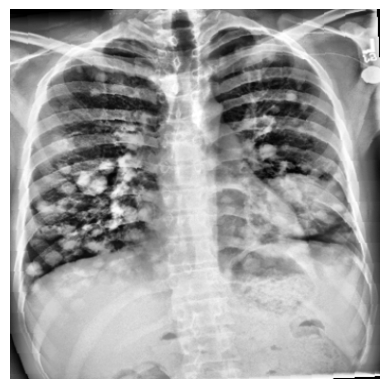

True label:
['Mass', 'Nodule']
Predicted label:
['Nodule']


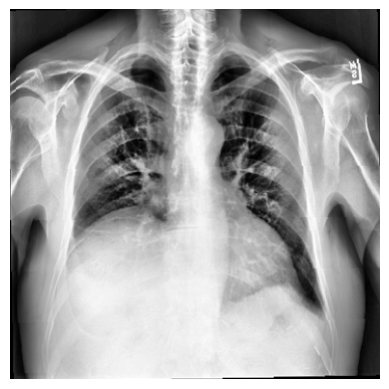

True label:
['Effusion']
Predicted label:
['Atelectasis']


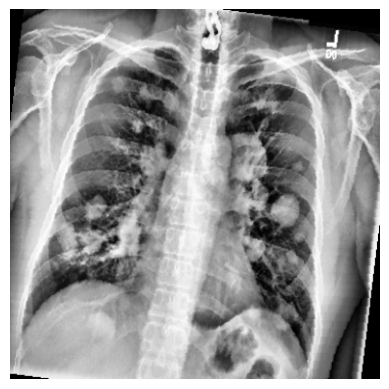

True label:
['Mass']
Predicted label:
['Mass', 'Nodule']


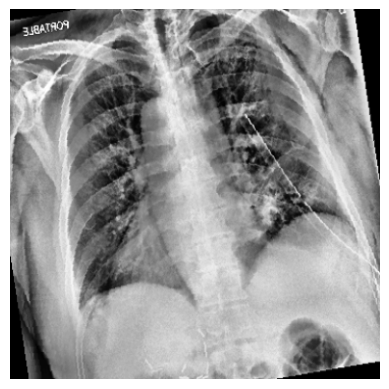

True label:
['Emphysema', 'Pneumothorax']
Predicted label:
['Emphysema']


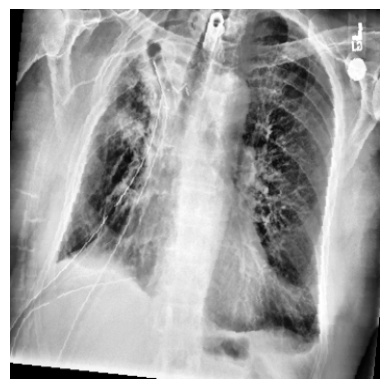

True label:
['Effusion', 'Infiltration']
Predicted label:
['Pneumothorax']


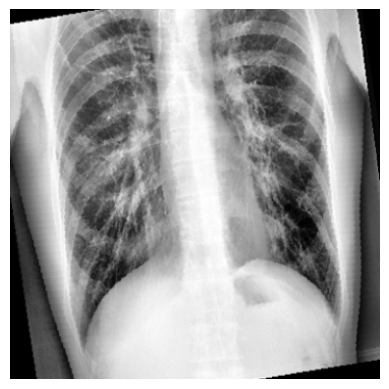

True label:
['Infiltration']
Predicted label:
['Fibrosis']


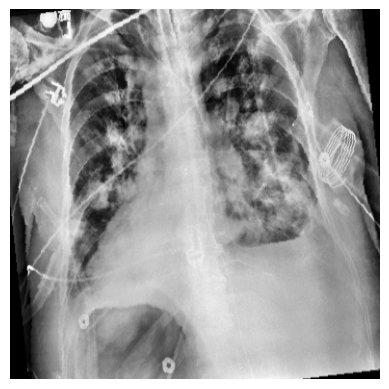

True label:
['Nodule']
Predicted label:
['Nodule', 'Effusion']


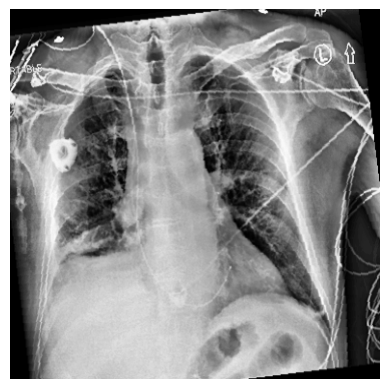

True label:
[]
Predicted label:
['Atelectasis', 'Effusion']


In [92]:
AdaptiveFPNResNet_correct_images , AdaptiveFPNResNet_incorrect_images = display_images(AdaptiveFPNResNet(num_classes),'results/AdaptiveFPNResNet_classifier_24epochs_mod.pt',test_loader,clables,num_sample=15)

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0')


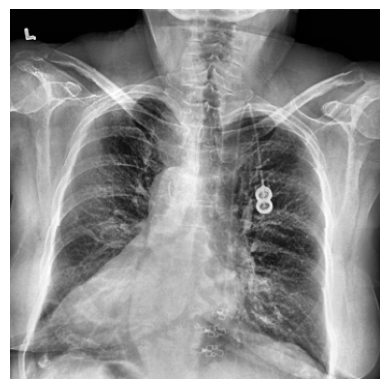

[]
tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       device='cuda:0')


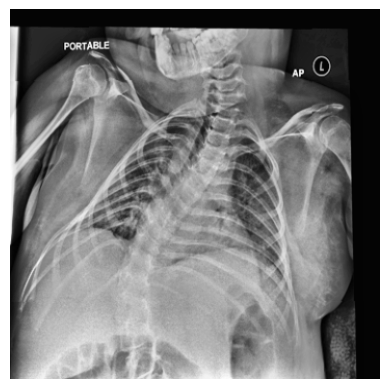

['Infiltration']


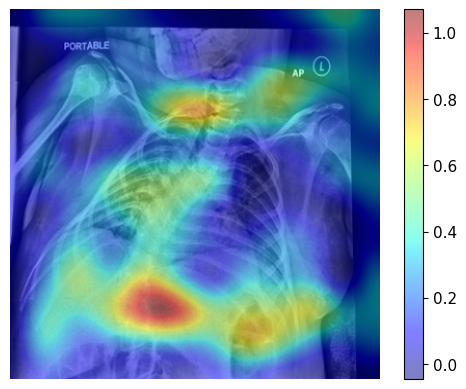

tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0')


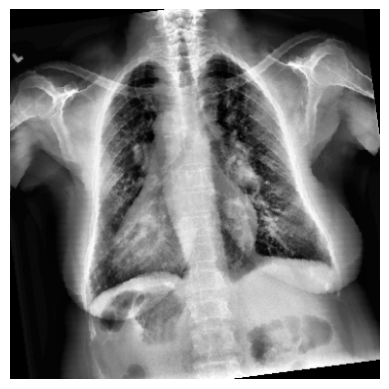

['Cardiomegaly']


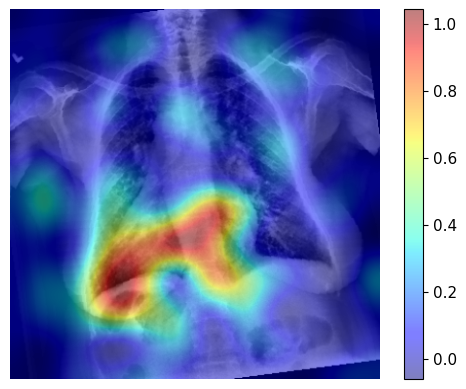

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.],
       device='cuda:0')


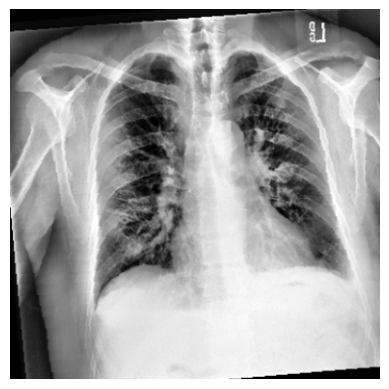

['Effusion']


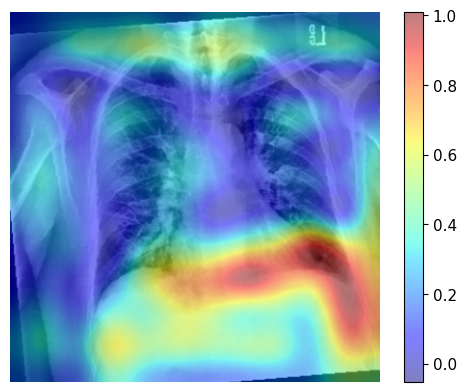

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.],
       device='cuda:0')


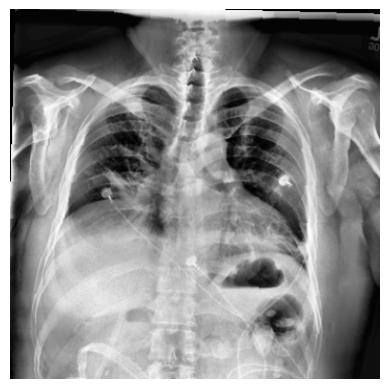

['Atelectasis']


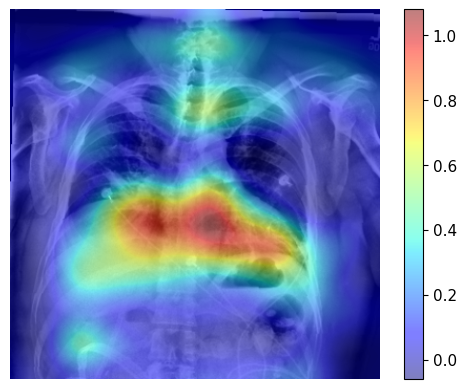

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.],
       device='cuda:0')


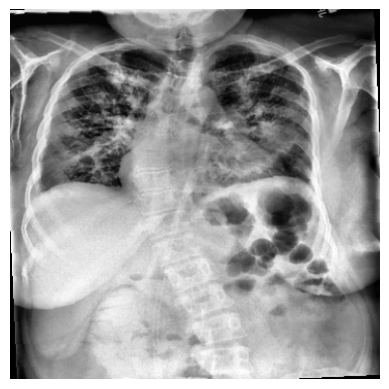

['Effusion', 'Infiltration']


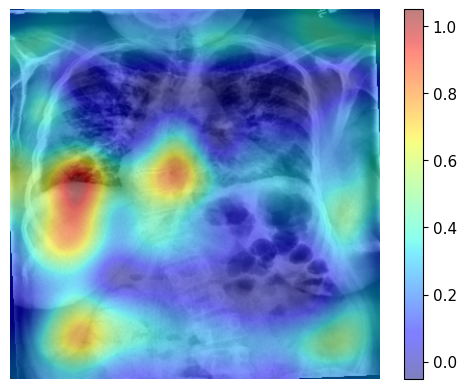

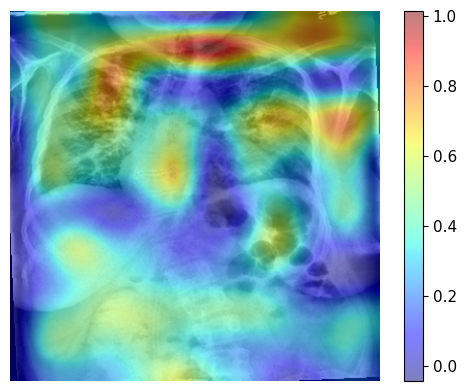

tensor([0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
       device='cuda:0')


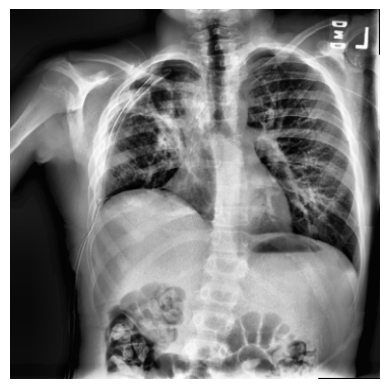

['Pneumothorax']


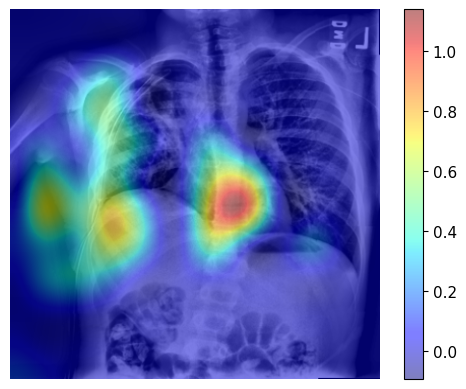

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.],
       device='cuda:0')


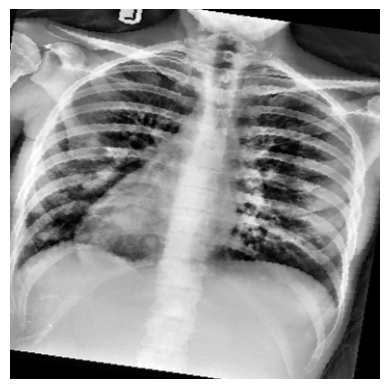

['Nodule']


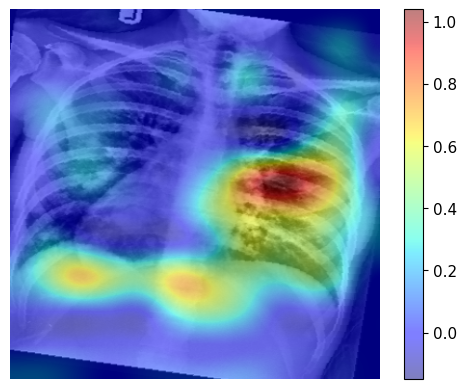

tensor([0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       device='cuda:0')


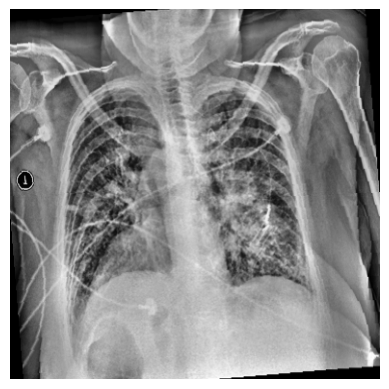

['Edema', 'Infiltration']


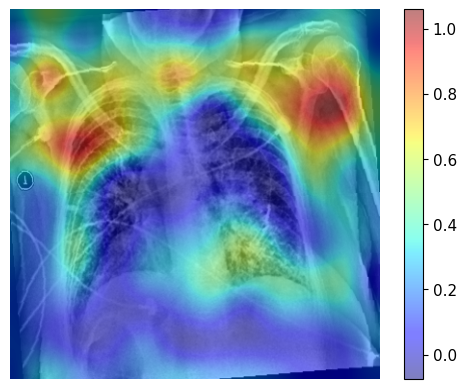

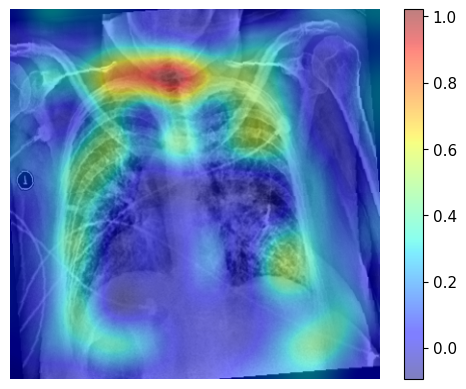

tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       device='cuda:0')


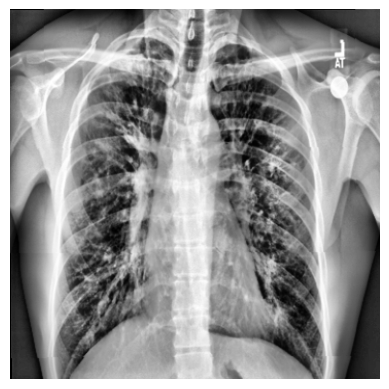

['Fibrosis']


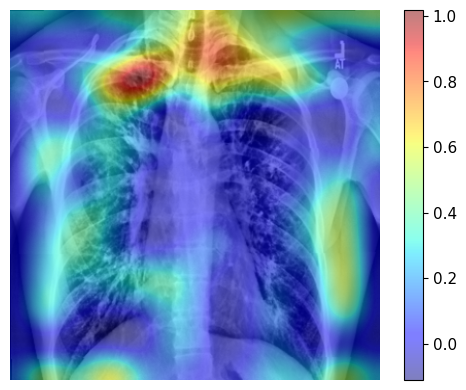

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1.],
       device='cuda:0')


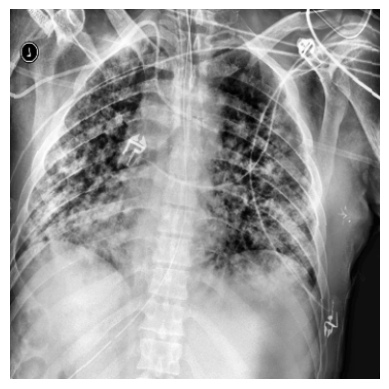

['Nodule', 'Infiltration']


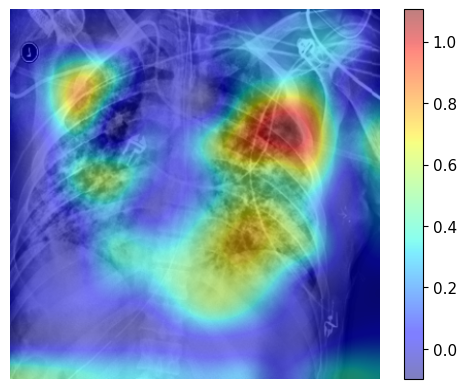

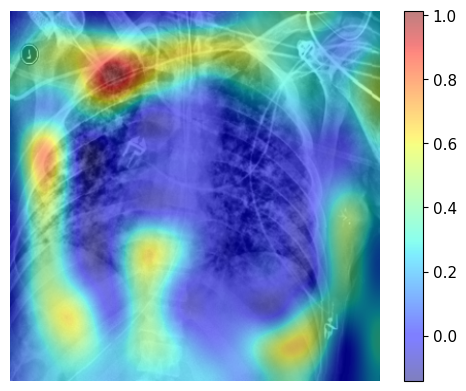

tensor([0., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
       device='cuda:0')


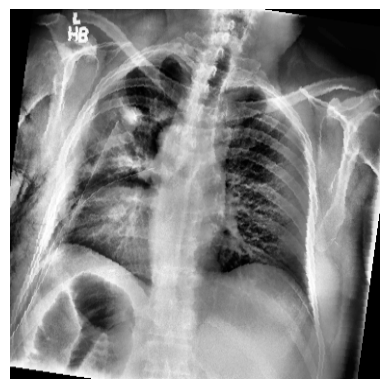

['Emphysema', 'Pneumothorax']


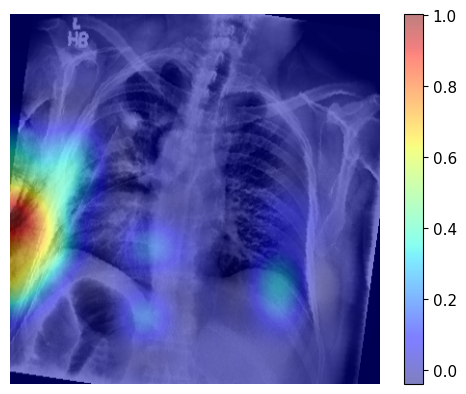

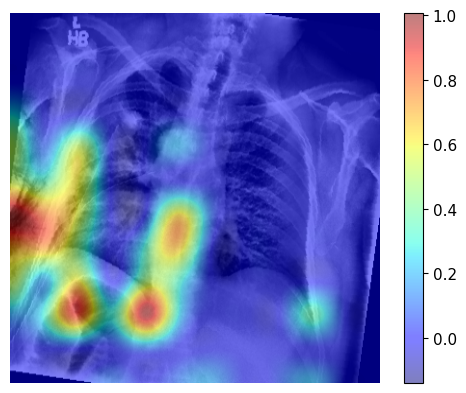

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0., 0.],
       device='cuda:0')


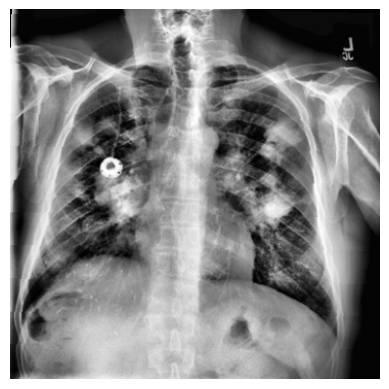

['Mass', 'Nodule']


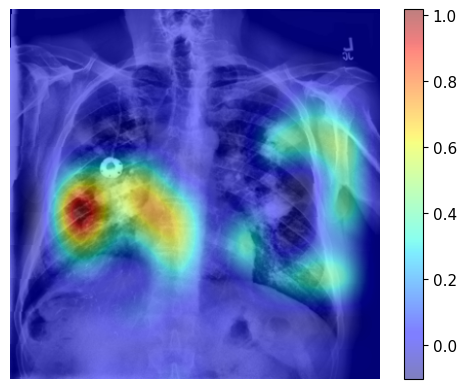

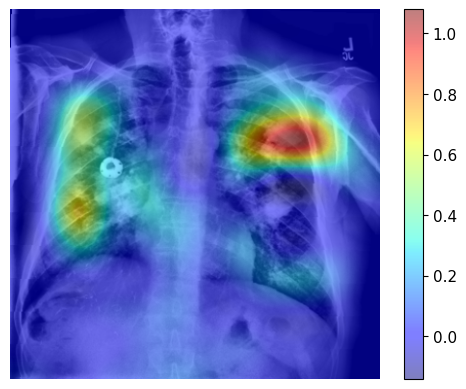

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0.],
       device='cuda:0')


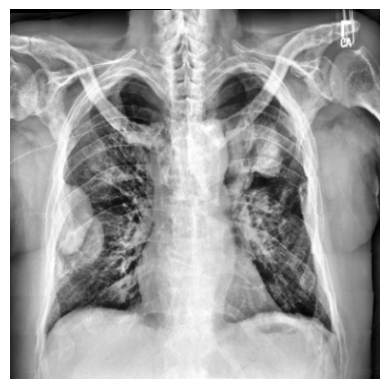

['Mass']


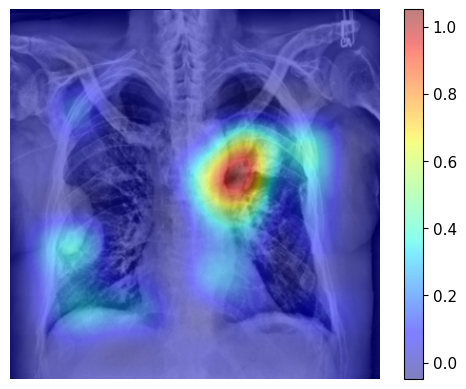

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0.],
       device='cuda:0')


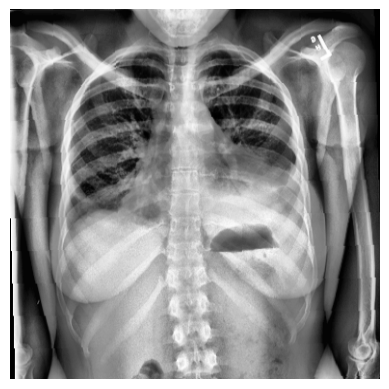

['Atelectasis', 'Effusion']


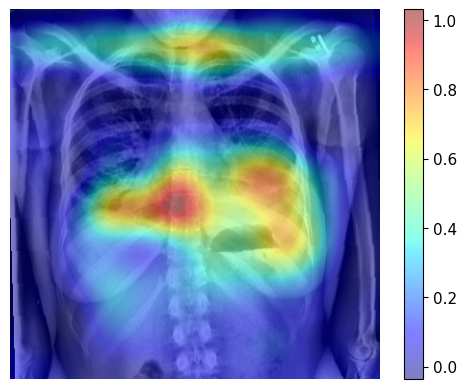

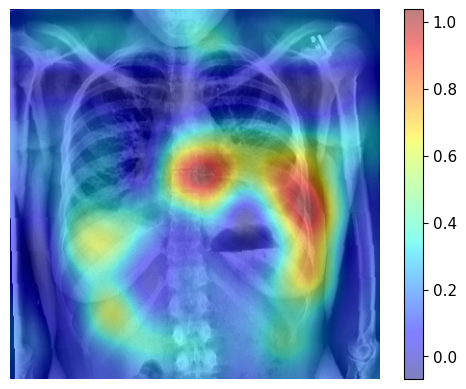

In [93]:
model = AdaptiveFPNResNet(num_classes)  # 初始化你的模型
state_dict = torch.load('results/AdaptiveFPNResNet_classifier_24epochs_stat.pt', map_location=device)["state_dict"]
# 从字典中加载权重到模型实例中
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
modellayer = model.resnet.layer4[2].conv3
#target_layer = MultiLabelDenseNet(num_classes).densenet.features.denseblock4.denselayer16.conv2
for img,label,predict in AdaptiveFPNResNet_correct_images:
        img = img.unsqueeze(0)
        print(label)
        display_gradcam(model,modellayer, img, clables,threshold_type)


In [75]:
torch.autograd.set_detect_anomaly(True)


[0, 2, 4, 6, 7, 8, 9, 11, 12]


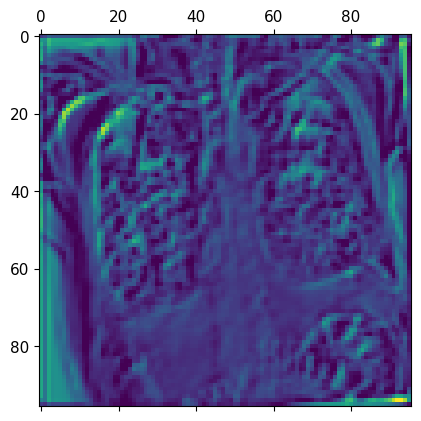

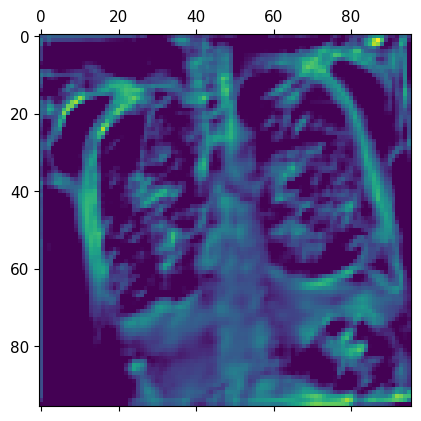

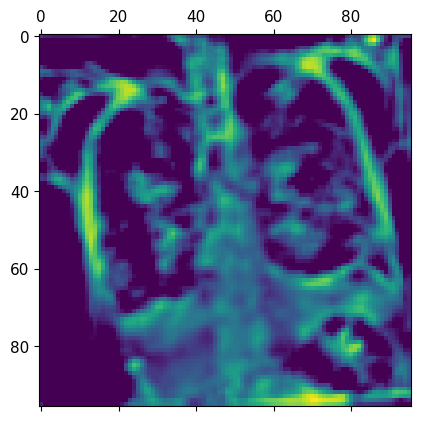

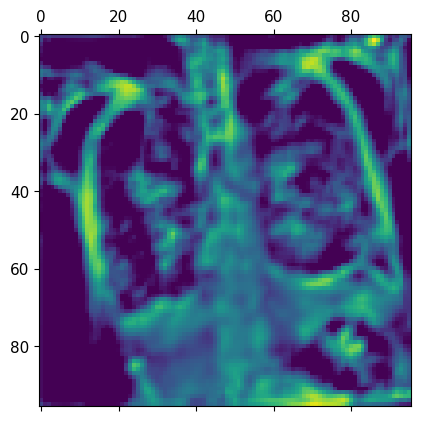

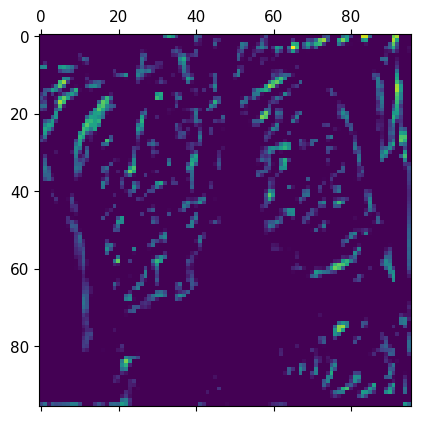

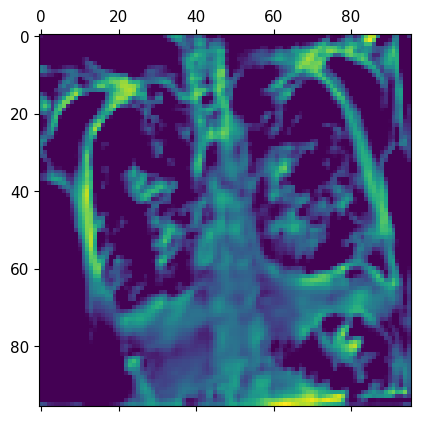

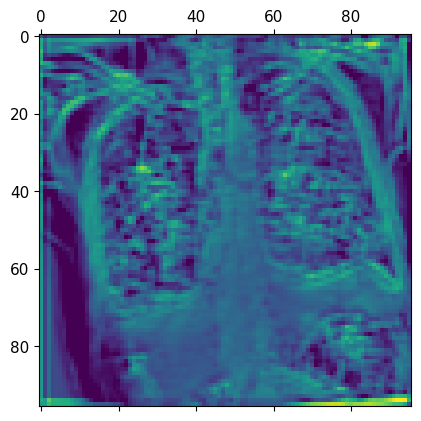

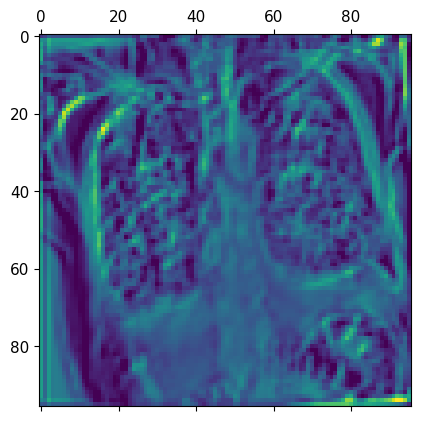

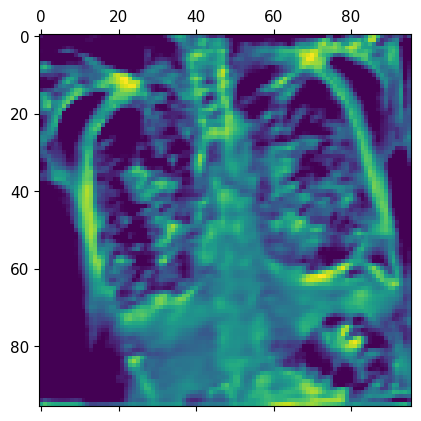

In [173]:
model = MultiTaskModel(num_classes)
state_dict = torch.load('results/MultiTaskModel_classifier_24epochs_stat.pt', map_location=device)["state_dict"]
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
modellayer = model.resnet[7][2].conv3
#target_layer = MultiLabelDenseNet(num_classes).densenet.features.denseblock4.denselayer16.conv2
display_gradcam(model,modellayer, image, clables,threshold_type)

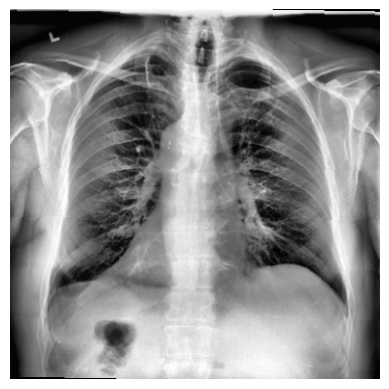

[13]


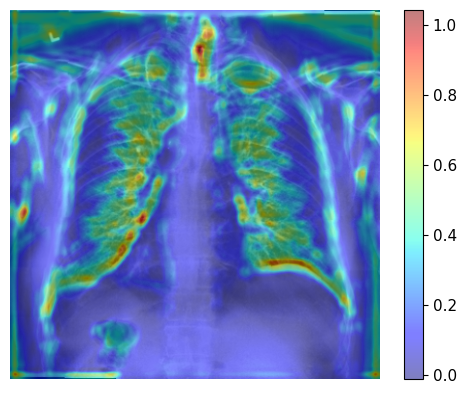

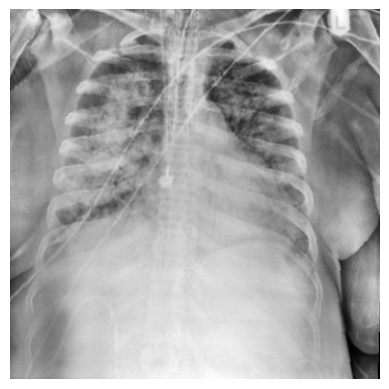

[1, 3, 13]


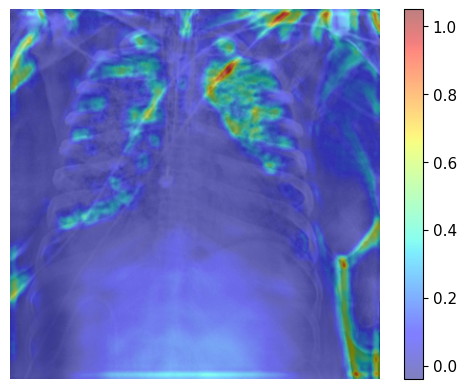

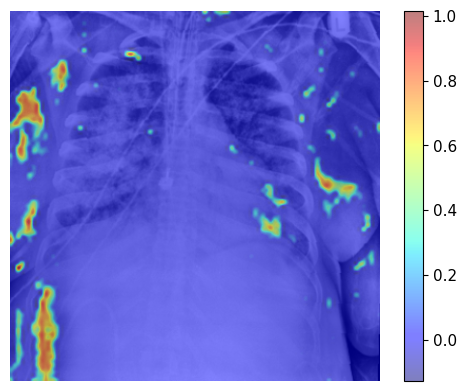

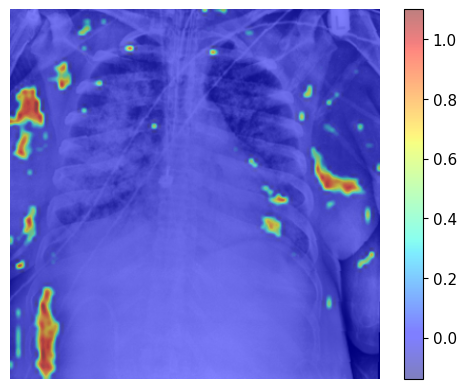

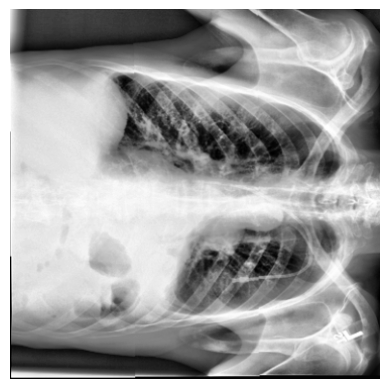

[10, 12]


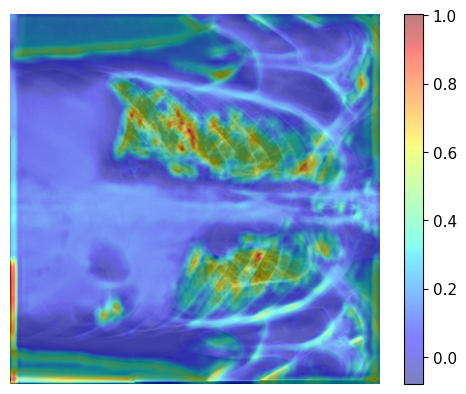

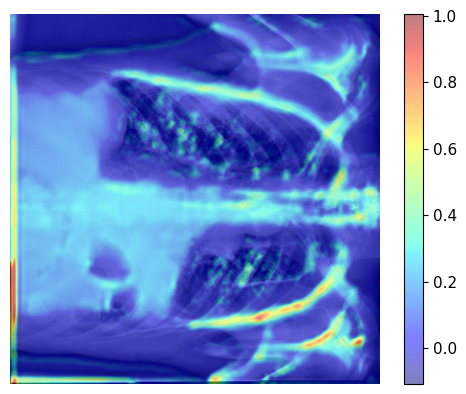

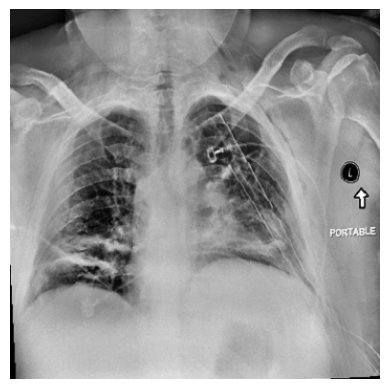

[11, 13]


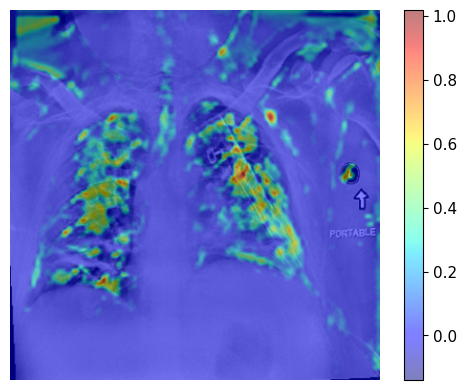

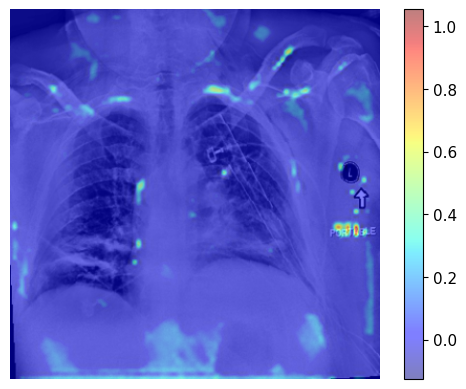

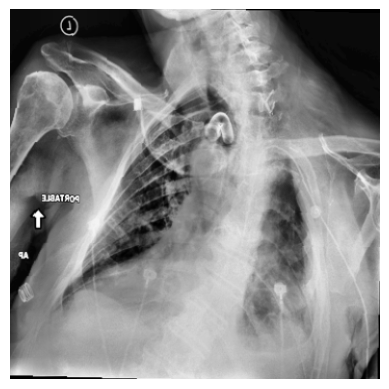

[6, 9, 10, 11, 13]


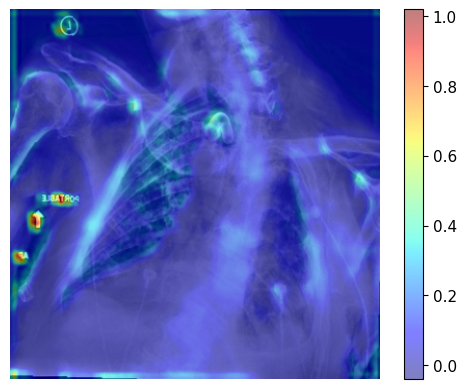

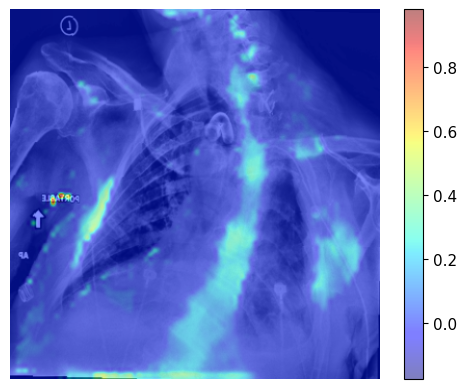

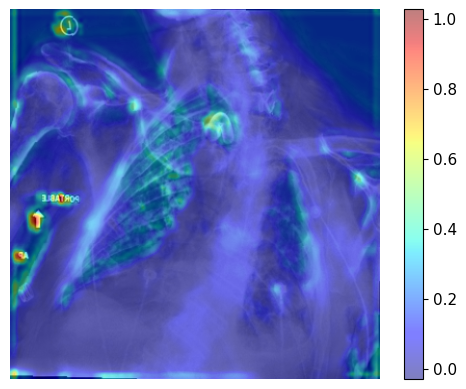

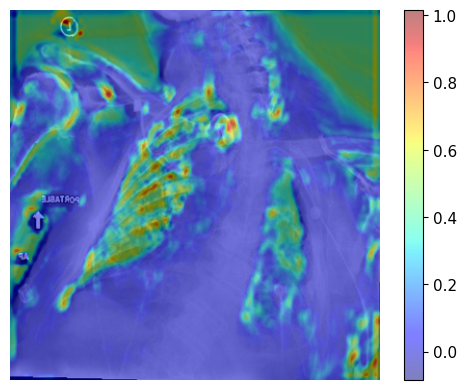

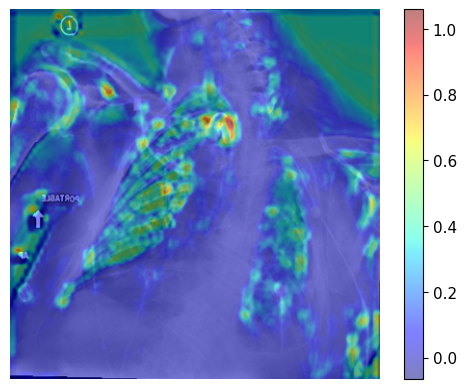

In [124]:
model = MultiLabelCNN(num_classes)  # 初始化你的模型
state_dict = torch.load('results/MYCNN_classifier_24epochs_stat.pt', map_location=device)["state_dict"]
# 从字典中加载权重到模型实例中
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
modellayer = model.conv3

for img,label,predict in correct_images:
    display_gradcam(model,modellayer, img.unsqueeze(0), clables,threshold_type)

In [114]:
def plot_roc_curves(y_true, y_probas, num_classes,clables):
    plt.figure(figsize=(10, 8))
    for i in range(num_classes):
        fpr, tpr, _ = roc_curve(y_true[i], y_probas[i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{clables[i]} (area = {roc_auc:.2f})')
    
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curves')
    plt.legend(loc="lower right")
    plt.show()

In [115]:
def eval_model(loader, model, num_classes, threshold_type,clables):
    correct = 0
    total = 0
    true_positives = 0
    false_positives = 0
    false_negatives = 0
    y_true = [[] for _ in range(num_classes)]
    y_probas = [[] for _ in range(num_classes)]

    if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
        optimize_threshold(val_loader, model, num_classes, threshold_type, 0.2)
        print(curr_best_thresholds)

    with torch.no_grad():
        for data in loader:
            images, labels = data
            images = images.cuda()
            labels = labels.to(device)
            outputs = model(images)

            if threshold_type == "local-F1-score" or threshold_type == "local-F1beta-score":
                curr_best_thresholds_tensor = curr_best_thresholds.clone().detach().to(device)
                predicted = (outputs >= curr_best_thresholds_tensor).float()
            else:
                threshold = 0.5
                predicted = torch.where(outputs >= threshold, 1., 0.)

            total += labels.size(0)
            
            for label, output in zip(labels, outputs):
                for i in range(num_classes):
                    y_true[i].append(label[i].cpu().numpy())
                    y_probas[i].append(output[i].cpu().numpy())
            
            for predict, label in zip(predicted, labels):
                if (predict == label).all():
                    correct += 1
                for i, j in zip(predict, label):
                    if (i == 0 and j == 1):
                        false_negatives += 1
                    if (i == 1 and j == 0):
                        false_positives += 1
                    if (i == 1 and j == 1):
                        true_positives += 1
    plot_roc_curves(y_true, y_probas, num_classes,clables)
    accuracy = correct / total
    precision = true_positives / (true_positives + false_positives + 1e-10)
    recall = true_positives / (true_positives + false_negatives + 1e-10)
    f1 = 2 * (precision * recall) / (precision + recall + 1e-10)
    aucs = [roc_auc_score(y_true[i], y_probas[i]) for i in range(num_classes)]
    avg_auc = sum(aucs) / num_classes
    
    return accuracy, precision, recall, f1, avg_auc, aucs


/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


tensor([0.2254, 0.0696, 0.1469, 0.1022, 0.1921, 0.1627, 0.1045, 0.1025, 0.1222,
        0.0977, 0.1629, 0.2047, 0.2216, 0.1789], device='cuda:0')


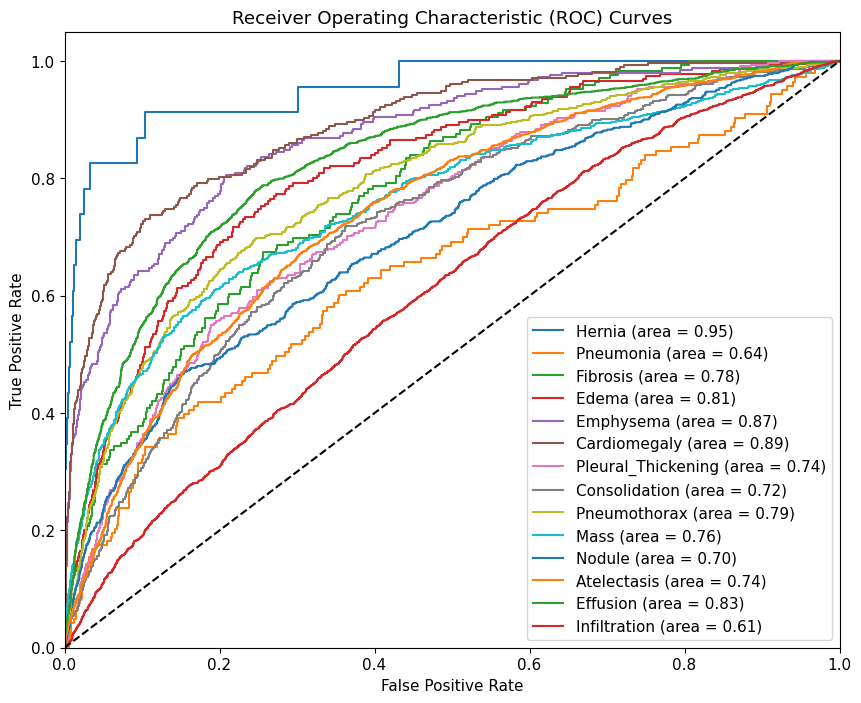

In [116]:
model = MultiTaskModel(num_classes)
state_dict = torch.load('results/MultiTaskModel_classifier_24epochs_stat.pt', map_location=device)["state_dict"]
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
accuracy, precision, recall, f1, avg_auc,aucs = eval_model(test_loader, model, num_classes, threshold_type,clables)

In [125]:
print(f1)

0.40204556015755816


/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


tensor([0.2254, 0.0696, 0.1469, 0.1022, 0.1859, 0.1627, 0.1463, 0.1025, 0.1222,
        0.0977, 0.1629, 0.2047, 0.2216, 0.1789], device='cuda:0')


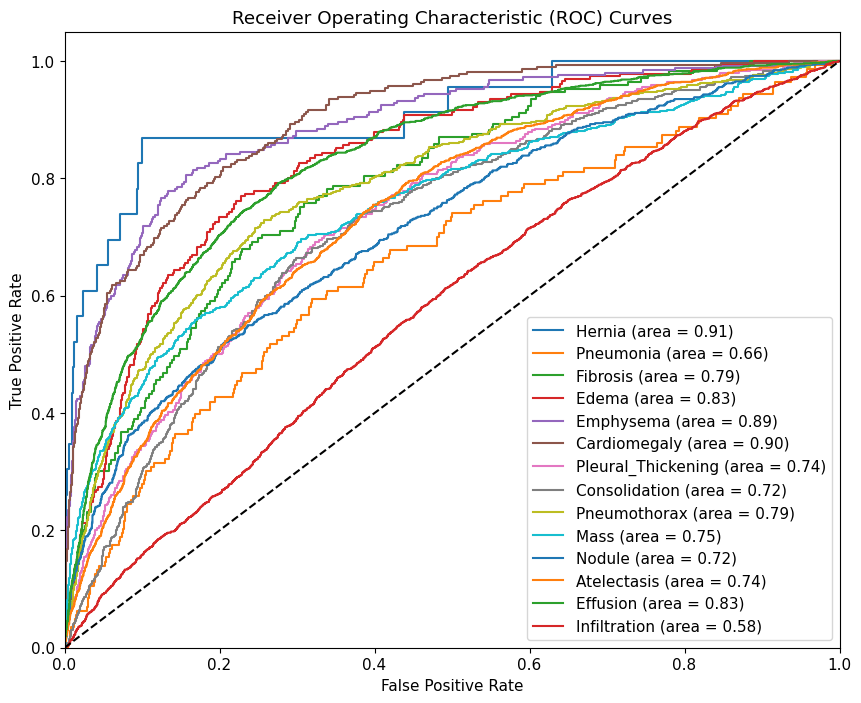

In [129]:
model = MultiLabelResNetNF(num_classes)
state_dict = torch.load('results/ResNet_classifier_18epochs_stat.pt', map_location=device)["state_dict"]
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
accuracy, precision, recall, f1, avg_auc,aucs = eval_model(test_loader, model, num_classes, threshold_type,clables)

/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/root/miniconda3/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


tensor([0.5908, 0.0572, 0.1948, 0.1064, 0.1173, 0.1969, 0.1538, 0.1268, 0.2534,
        0.2000, 0.1339, 0.2790, 0.2374, 0.2068], device='cuda:0')


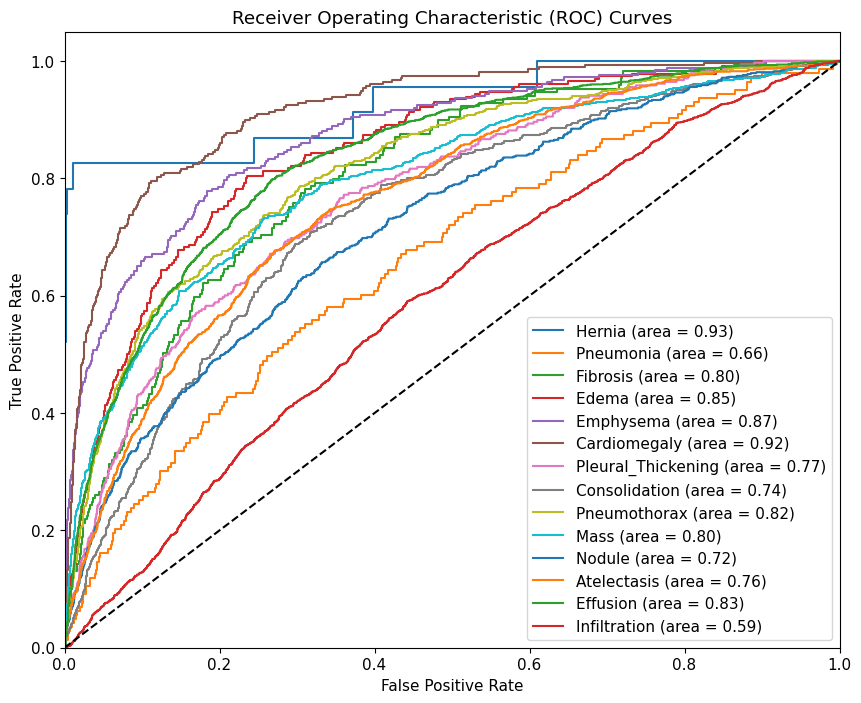

In [135]:
model = MultiLabelDenseNet(num_classes)
state_dict = torch.load('results/DensNet_classifier_24epochs_stat.pt', map_location=device)["state_dict"]
model.load_state_dict(state_dict)
model = model.to(device)
model.eval()
accuracy, precision, recall, f1, avg_auc,aucs = eval_model(test_loader, model, num_classes, threshold_type,clables)